In [1]:
import numpy as np
import pandas as pd

import scipy.sparse as sparse
import scipy.sparse.linalg as slin
from scipy.stats import binom
from scipy import signal

import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
import plotly.express as px

from higlass.client import View, Track, ViewConf, CombinedTrack, ViewportProjection
from clodius.tiles import npmatrix
from higlass.tilesets import Tileset 
from higlass.tilesets import cooler as hgcool
import higlass.client as hgc
import higlass

from exoc_funcs import interval, interval_maker

import cooltools
import cooler
import bioframe

import os

import h5py


sns.set()
pd.set_option('display.max_rows', 500)

# Graphics in retina format are more sharp and legible
%config InlineBackend.figure_format = 'retina'
%load_ext autoreload
%autoreload 2

# Patients analysis

In [2]:
workdir = "/mnt/a/!Work/tmp/Exoc/accurasy_test/"

In [3]:
art_sample = {'arr[hg19]': [],
              'inversion': [],
              'translocation': [],
              'rob': [],
              'arr[GRCh37]': [],
              'der': [],
              'sex': None,
             }

In [4]:
artifacts_dict = {}
with open(workdir + 'all_translocations.txt') as file:
    line = file.readline()[:-1].split('\t')
    while len(line)>1:
        artifacts_dict[line[0]] = art_sample.copy()
        artifacts_dict[line[0]]['sex'] = line[1]
        for ar in line[2:]:
            if not ar == '':
                ar_type, ar_coords = ar.split(':')
                artifacts_dict[line[0]][ar_type] = ar_coords.split(',')
        
        line = file.readline()[:-1].split('\t')

In [5]:
artifacts_dict_base = {}
with open(workdir + 'all_translocations_base.txt') as file:
    line = file.readline()[:-1].split('\t')
    while len(line)>1:
        artifacts_dict_base[line[0]] = art_sample.copy()
        artifacts_dict_base[line[0]]['sex'] = line[1]
        for ar in line[2:]:
            if not ar == '':
                ar_type, ar_coords = ar.split(':')
                artifacts_dict_base[line[0]][ar_type] = ar_coords.split(',')
        
        line = file.readline()[:-1].split('\t')

In [6]:
def true_pair(artifacts_dict, pat_id, chr_pair):
    if pat_id in artifacts_dict.keys():
        if chr_pair in artifacts_dict[pat_id]['translocation'] or chr_pair in artifacts_dict[pat_id]['rob']:
            return True
        else:
            return False
    else:
        return None

In [7]:
data_line = pd.DataFrame()
s4s = "-all_artifacts_line.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        try:
            tmp = pd.read_csv(workdir + file)
        except:
            pass
        else:
            tmp['pat_id'] = file.split('-')[0]
            data_line = data_line.append(tmp, ignore_index=True)
# data_line = pd.read_csv(workdir + f'full_table')
        
data_line['x_interval'] = data_line['x_interval'].apply(interval.from_str)
data_line['y_interval'] = data_line['y_interval'].apply(interval.from_str)

In [8]:
def XY_test(x):
    try:
        a = int(x)
    except ValueError:
        if x == 'X': a = 100
        if x == 'Y': a = 200
    return a

data_line['chr_pair'] = data_line[['from_chr', 'to_chr']].apply(lambda x: f'{x[0]}-{x[1]}' if int(XY_test(x[0][3:]))<int(XY_test(x[1][3:])) else f'{x[1]}-{x[0]}', axis=1)
data_line['true_pair'] = data_line[['pat_id', 'chr_pair']].apply(lambda x: true_pair(artifacts_dict, x[0], x[1]), axis=1)

In [9]:
data_base = pd.DataFrame()
s4s = "-all_artifacts.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        tmp = pd.read_csv(workdir + file)
        tmp['pat_id'] = file.split('-')[0]
        data_base = data_base.append(tmp, ignore_index=True)
# data_base = pd.read_csv(workdir + f'full_table')
        
data_base['x_interval'] = data_base['x_interval'].apply(interval.from_str)
data_base['y_interval'] = data_base['y_interval'].apply(interval.from_str)

In [10]:
data_base = data_base[(data_base['prob'] > 0) * (data_base['chrX'] != data_base['chrY'])]
data_base['chr_pair'] = data_base['chrX']+'-'+data_base['chrY']
data_base['true_pair'] = data_base[['pat_id', 'chr_pair']].apply(lambda x: true_pair(artifacts_dict, x[0], x[1]), axis=1)

In [11]:
k = 1.73
k_base = (2.4 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
data_line['answer'] = ((np.exp(k*np.log10(data_line['counts_pat'])) < data_line['from_stat_binom']) | (data_line['from_stat_binom'] > 330))  & (data_line['resolution']<200e3)
# data_line['answer'] = False
data_base['answer'] = (data_base['resolution'] >= 16e3) & (np.log10(data_base['prob']) >= k_base*np.log10(data_base['pat_sum'])+b_base) & (data_base['pat_sum'] > 10)

In [12]:
data_line[data_line['answer'] & (data_line['pat_id']=='s214_P137')] #.groupby('chr_pair').count().sort_values('resolution', ascending=False)

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,chr_pair,true_pair,answer
974,16000,1935.0,47889.0,chr16,chr1,4430.0,4449.0,20.0,"[70880000.0,71200000.0)",347.278150,9320.0,9720.0,"[149120000.0,155536000.0)",7.600530,s214_P137,chr1-chr16,False,True
977,16000,315.0,8694.0,chr2,chr1,5735.0,5738.0,4.0,"[91760000.0,91824000.0)",119.233862,9477.0,9557.0,"[151632000.0,152928000.0)",1.372224,s214_P137,chr1-chr2,False,True
979,1000,45.0,1491.0,chr16,chr1,71061.0,71065.0,5.0,"[71061000.0,71066000.0)",17.534864,112120.0,112220.0,"[112120000.0,112221000.0)",0.641733,s214_P137,chr1-chr16,False,True


In [13]:
# data_base[data_base['answer'] & (data_base['pat_id']=='s214_P137')][['pat_id', 'chrX', 'chrY', 'prob', 'pat_sum', 'resolution', 'chr_pair', 'dot_prob']] #.groupby('chr_pair').count()

In [14]:
data_base['pat_sum'] = data_base['pat_sum'].apply(lambda x: int(x))

In [15]:
fig = px.scatter(data_line, 
                 x = np.log10(abs(data_line['counts_pat'])),
                 y = 'from_stat_binom',
                 hover_data = ['pat_id', 'from_chr', 'to_chr'],
                 color = 'true_pair',
                 symbol = 'resolution',
                )
x = np.linspace(1.5,3.4,100)
k = 1.73
fig.add_trace(go.Scatter(
    x = x,
    y = np.exp(k*x),
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [16]:
# mask = data_base['pat_id']=='s99_TAF3'
fig = px.scatter(data_base, 
                 x = np.log10(abs(data_base['pat_sum'])),
                 y = np.log10(abs(data_base['prob'])),
                 hover_data = ['pat_id', 'chrX', 'chrY'],
                 color = 'true_pair',
                 symbol = 'resolution',
#                  symbol = 's_init',
                )
x = np.linspace(0.5,4.5,100)
k_base = (2.4 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
fig.add_trace(go.Scatter(
    x = x,
    y = k_base*x+b_base,
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [17]:
k = 1.73
k_base = (2.4 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
data_line['answer'] = ((np.exp(k*np.log10(data_line['counts_pat'])) < data_line['from_stat_binom']) | (data_line['from_stat_binom'] > 330)) & (data_line['resolution']<200e3)
# data_line['answer'] = False
data_base['answer'] = (data_base['resolution'] >= 16e3) & (np.log10(data_base['prob']) >= k_base*np.log10(data_base['pat_sum'])+b_base) & (data_base['pat_sum'] > 10)

In [18]:
answer_base = data_base[data_base['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_base: answer_base[pat_id] = list(answer_base[pat_id])
answer_line = data_line[data_line['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_line: answer_line[pat_id] = list(answer_line[pat_id])
answer = answer_base.copy()
for pat_id in answer_line:
    if pat_id in answer:
        answer[pat_id] = list(set(answer_line[pat_id] + answer[pat_id]))
    else:
        answer[pat_id] = answer_line[pat_id]

for pat_id in artifacts_dict:
    if pat_id in answer:
        print(pat_id)
        print(sorted(answer[pat_id]))
        print(sorted(artifacts_dict[pat_id]['translocation'] + artifacts_dict[pat_id]['rob']))

    else:
        print(pat_id)
        print('----')
        print(sorted(artifacts_dict[pat_id]['translocation']))
    
    print()

s90_P26
----
[]

s91_P31
----
[]

s92_P32
----
[]

s93_P35
['chr9-chrX']
[]

s95_P37
['chr9-chr17']
[]

s96_P38
['chr11-chr19', 'chr14-chr19']
[]

s97_P40
----
[]

s98_P39
----
[]

s132_P10
['chr4-chr13', 'chr5-chr10']
['chr4-chr13', 'chr5-chr10']

s133_P42
['chr4-chr12', 'chr9-chr19']
['chr4-chr12']

s134_P43
['chr2-chr4', 'chr4-chr11', 'chr8-chr17']
['chr2-chr4']

s135_P46
['chr6-chr18', 'chr6-chr21']
['chr6-chr18', 'chr6-chr21']

s136_P47
['chr11-chr20', 'chr20-chr21', 'chr8-chr11', 'chr8-chr20', 'chr8-chr21']
['chr11-chr20', 'chr20-chr21', 'chr8-chr11', 'chr8-chr21']

s137_P48
----
[]

s138_P49
----
[]

s139_P50
['chr1-chr9']
['chr1-chr9']

s140_P51
['chr1-chr9']
['chr1-chr9']

s141_P52
----
[]

s159_P44
['chr5-chr13']
['chr5-chr13']

s160_P45
['chr13-chr14', 'chr9-chr14']
['chr13-chr14']

s161_P53
----
[]

s162_P54
['chr2-chr18']
['chr2-chr18']

s163_P55
['chr3-chr16', 'chr3-chr6', 'chr6-chr16', 'chr6-chr7', 'chr7-chr16']
['chr7-chr16']

s164_P57
['chr3-chr10']
['chr3-chr10']

s16

In [19]:
# black_list = ['s99_TAF3', 's100_TAF4', 's101_TAF9', 's214_P137']
black_list = []

In [20]:
tp, fp, fn = 0, 0, 0
for pat_id in artifacts_dict:
    if pat_id not in black_list:
        if pat_id in answer:
            tmp_true = artifacts_dict[pat_id]['translocation'] + artifacts_dict[pat_id]['rob']
            for tmp_tr in answer[pat_id]:
                if tmp_tr in tmp_true: 
                    tp += 1
                else:
                    fp += 1
                    
            if len(set(tmp_true) - set(answer[pat_id])) != 0:
#                 pr_rc_df['fn'][pr_rc_df['keys']==p] += len(set(tmp_true) - set(answer[pat_id]))
                fn += len(set(tmp_true) - set(answer[pat_id]))
        else:
            fn += len(artifacts_dict[pat_id]['translocation'])

# map_real_trans = 5
# fp -= map_real_trans
# tp += map_real_trans
print(f'TP: {tp}, FP: {fp}, FN: {fn}\nPrecision: {tp/(tp+fp)}, Recall: {tp/(tp+fn)}')

TP: 31, FP: 39, FN: 0
Precision: 0.44285714285714284, Recall: 1.0


In [21]:
for pat_id in artifacts_dict:
    a = sorted(artifacts_dict[pat_id]['translocation'] + artifacts_dict[pat_id]['rob'])
    b = sorted(artifacts_dict_base[pat_id]['translocation'] + artifacts_dict_base[pat_id]['rob'])
    if a!=b:
        print(pat_id)
        print(set(a) - set(b))

        print()

s132_P10
{'chr4-chr13'}

s136_P47
{'chr11-chr20', 'chr20-chr21'}

s167_P63
{'chr2-chr7'}

s203_P119
{'chr5-chr12'}

s210_P132
{'chr5-chr12'}



In [22]:
# mask = data_line['answer']
# data_line[mask][(data_line[mask]['resolution']*data_line[mask]['size'] < 2e6) & (data_line[mask]['pat_id'].apply(lambda x: x not in black_list))]

In [23]:
# mask = data_base['answer']
# data_base[mask][(data_base[mask]['resolution']*data_base[mask]['size'] < 2e6) & (data_base[mask]['pat_id'].apply(lambda x: x not in black_list))]

In [24]:
# mask = data_base['pat_id'].apply(lambda x: x not in black_list)
# data_base[mask][data_base['answer']]

In [25]:
# mask = data_line['pat_id'].apply(lambda x: x not in black_list)
# data_line[mask][data_line['answer']]

In [26]:
tmp_cis_fp = pd.DataFrame()
tmp_fp_stats = {"P137": 10, "P124": 9, "P42": 1, "P37": 1, "P43": 1, "TAF3": 18, "TAF4": 10, "K562": -1, "TAF9": 4, "TAF16": 23, "P38": 2, "P45": 2, "P70": 1, "P113": 1}
tmp_cis_fp['names'] = ["P137", "P124", "P42", "P37", "P43", "P69", "P112", "P38", "P44", "P63", "P46", "P70", "P51", "P45", "P54", "P39", "P58", "P49", "P71", "P50", "P62", "P123", "P53", "P55", "P78", "P10", "P122", "P48", "P104", "P107", "P108", "P109", "P125", "P113", "P114", "P47", "P115", "P35", "P52", "P57", "P73", "P103", "P26", "P83", "P139", "P135", "P31", "P82", "P84", "P92", "P133", "P131", "P132", "P86", "P91", "P119", "P32", "P40", "P88", "P136", "TAF3", "TAF4", "P65", "K562", "TAF9", "TAF16"]
tmp_cis_fp['cis'] = [41, 43, 48, 53, 53, 54, 57, 57, 57, 57, 58, 58, 59, 60, 60, 61, 61, 62, 62, 63, 63, 64, 64, 64, 64, 65, 65, 65, 66, 66, 66, 66, 67, 67, 67, 67, 68, 68, 68, 68, 68, 69, 69, 69, 70, 70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 72, 72, 72, 72, 72, 75, 76, 77, 81, 82, 89]
tmp_cis_fp['fp'] = tmp_cis_fp['names'].apply(lambda x: tmp_fp_stats[x] if x in tmp_fp_stats else 0)
tmp_cis_fp['enrich'] = [70.47, 54.97, 83.99, 92.57, 79.51, 81.03, 65.07, 93.38, 76.21, 76.69, 79.94, 71.91, 80.30, 74.54, 77.25, 88.55, 76.95, 78.05, 81.26, 74.75, 87.85, 55.58, 76.56, 78.99, 64.14, 81.76, 55.93, 77.89, 64.56, 65.71, 62.43, 66.28, 73.36, 63.15, 61.68, 80.33, 54.22, 89.56, 80.93, 80.54, 60.03, 65.57, 89.28, 63.61, 72.09, 73.57, 89.34, 63.61, 61.11, 53.12, 74.34, 73.17, 73.51, 63.15, 66.00, 61.42, 88.64, 89.01, 62.49, 74.24, 81.50, 86.86, 65.54, 84.70, 84.99, 61.84]
tmp_cis_fp['DE'] = [38, 33, 67, 76, 56, 76, 42, 72, 53, 52, 59, 48, 59, 48, 57, 71, 67, 53, 61, 52, 77, 33, 59, 71, 44, 68, 30, 53, 41, 39, 36, 44, 40, 36, 35, 58, 32, 75, 59, 62, 38, 42, 68, 50, 40, 42, 75, 47, 42, 30, 42, 43, 41, 46, 60, 44, 73, 70, 48, 47, 67, 66, 67, 58, 73, 43]
tmp_cis_fp['batch'] = [7, 6, 2, 1, 2, 3, 5, 1, 3, 3, 2, 3, 2, 3, 3, 1, 3, 2, 3, 2, 3, 6, 3, 3, 4, 2, 6, 2, 5, 5, 5, 5, 7, 5, 5, 2, 6, 1, 2, 3, 4, 5, 1, 4, 7, 7, 1, 4, 4, 6, 7, 7, 7, 4, 6, 6, 1, 1, 4, 7, 1, 1, 4, 2, 1, 4]
tmp_cis_fp

,names,cis,fp,enrich,DE,batch
0,P137,41,10,70.47,38,7
1,P124,43,9,54.97,33,6
2,P42,48,1,83.99,67,2
3,P37,53,1,92.57,76,1
4,P43,53,1,79.51,56,2
5,P69,54,0,81.03,76,3
6,P112,57,0,65.07,42,5
7,P38,57,2,93.38,72,1
8,P44,57,0,76.21,53,3
9,P63,57,0,76.69,52,3


In [27]:
# fig = px.scatter(tmp_cis_fp, 
#                  x = 'cis',
#                  y = 'DE',
#                  hover_data = ['names', 'enrich', 'batch', 'fp'],
#                  size = np.log(abs(tmp_cis_fp['fp']*5)+2),
# #                  symbol = 'batch',
#                  color = tmp_cis_fp['batch'].apply(lambda x: str(x)),
#                 )


# fig.update_layout(autosize=False, width=1000, height=800)
# # fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# # fig.update_layout(legend=dict(
# #     orientation="h",
# #     yanchor="bottom",
# #     y=1.02,
# #     xanchor="left",
# #     x=1
# # ))
# # fig.update_layout(hovermode=False)
# fig.show()

In [28]:
black_list = ["P70", "P73", "P114", "P115", "P122", "P123", "P125", "P131", "P133", "P139", "P124", "P26", "P35", "P39", "P71", "P78", "P109", "K562"]

In [29]:
# BAse transes

tp, fp, fn = 0, 0, 0

tmp_cis_fp = pd.DataFrame()
# tmp_fp_stats = {"P137": 10, "P124": 9, "P42": 1, "P37": 1, "P43": 1, "TAF3": 18, "TAF4": 10, "K562": -1, "TAF9": 4, "TAF16": 23, "P38": 2, "P45": 2, "P70": 1, "P113": 1}
tmp_cis_fp['names'] = ["P137", "P124", "P42", "P37", "P43", "P69", "P112", "P38", "P44", "P63", "P46", "P70", "P51", "P45", "P54", "P39", "P58", "P49", "P71", "P50", "P62", "P123", "P53", "P55", "P78", "P10", "P122", "P48", "P104", "P107", "P108", "P109", "P125", "P113", "P114", "P47", "P115", "P35", "P52", "P57", "P73", "P103", "P26", "P83", "P139", "P135", "P31", "P82", "P84", "P92", "P133", "P131", "P132", "P86", "P91", "P119", "P32", "P40", "P88", "P136", "TAF3", "TAF4", "iP65", "K562", "TAF9", "TAF16"]
tmp_cis_fp['cis'] = [41, 43, 48, 53, 53, 54, 57, 57, 57, 57, 58, 58, 59, 60, 60, 61, 61, 62, 62, 63, 63, 64, 64, 64, 64, 65, 65, 65, 66, 66, 66, 66, 67, 67, 67, 67, 68, 68, 68, 68, 68, 69, 69, 69, 70, 70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 72, 72, 72, 72, 72, 75, 76, 77, 81, 82, 89]
# tmp_cis_fp['fp'] = tmp_cis_fp['names'].apply(lambda x: tmp_fp_stats[x] if x in tmp_fp_stats else 0)
tmp_cis_fp['enrich'] = [70.47, 54.97, 83.99, 92.57, 79.51, 81.03, 65.07, 93.38, 76.21, 76.69, 79.94, 71.91, 80.30, 74.54, 77.25, 88.55, 76.95, 78.05, 81.26, 74.75, 87.85, 55.58, 76.56, 78.99, 64.14, 81.76, 55.93, 77.89, 64.56, 65.71, 62.43, 66.28, 73.36, 63.15, 61.68, 80.33, 54.22, 89.56, 80.93, 80.54, 60.03, 65.57, 89.28, 63.61, 72.09, 73.57, 89.34, 63.61, 61.11, 53.12, 74.34, 73.17, 73.51, 63.15, 66.00, 61.42, 88.64, 89.01, 62.49, 74.24, 81.50, 86.86, 65.54, 84.70, 84.99, 61.84]
tmp_cis_fp['batch'] = [7, 6, 2, 1, 2, 3, 5, 1, 3, 3, 2, 3, 2, 3, 3, 1, 3, 2, 3, 2, 3, 6, 3, 3, 4, 2, 6, 2, 5, 5, 5, 5, 7, 5, 5, 2, 6, 1, 2, 3, 4, 5, 1, 4, 7, 7, 1, 4, 4, 6, 7, 7, 7, 4, 6, 6, 1, 1, 4, 7, 1, 1, 4, 2, 1, 4]
tmp_cis_fp.set_index('names', inplace=True)
tmp_cis_fp['fp'] = 0
tmp_cis_fp['tp'] = 0
tmp_cis_fp['fn'] = 0
tmp_cis_fp['sex'] = '-'
tmp_cis_fp['seq'] = '-'

for pat_id in artifacts_dict_base:
    tmp_cis_fp['sex'][pat_id.split('_')[1]] = artifacts_dict_base[pat_id]['sex']
    tmp_cis_fp['seq'][pat_id.split('_')[1]] = pat_id.split('_')[0]
    if pat_id in answer:
        tmp_true = artifacts_dict_base[pat_id]['translocation'] + artifacts_dict_base[pat_id]['rob']
        for tmp_tr in answer[pat_id]:
            if tmp_tr in tmp_true: 
                tmp_cis_fp['tp'][pat_id.split('_')[1]] += 1
            else:
                tmp_cis_fp['fp'][pat_id.split('_')[1]] += 1
                
        if len(set(tmp_true) - set(answer[pat_id])) != 0:
#             pr_rc_df['fn'][pr_rc_df['keys']==p] += len(set(tmp_true) - set(answer[pat_id]))
            fn += len(set(tmp_true) - set(answer[pat_id]))
    else:
        tmp_cis_fp['fn'][pat_id.split('_')[1]] += len(artifacts_dict_base[pat_id]['translocation'])

tmp_cis_fp.reset_index(inplace=True)
# bl_mask = tmp_cis_fp['names'].apply(lambda x: x not in black_list)
bl_mask = tmp_cis_fp['names'].apply(lambda x: True)

tp = tmp_cis_fp[bl_mask]['tp'].sum()
fp = tmp_cis_fp[bl_mask]['fp'].sum()
fn = tmp_cis_fp[bl_mask]['fn'].sum()
pr = tp/(tp+fp)
rc = tp/(tp+fn)
print(f'TP: {tp}, FP: {fp}, FN: {fn}\nPrecision: {pr}, Recall: {rc}\nF1: {2*pr*rc/(pr+rc)}\nSamples: {bl_mask.sum()}')

TP: 25, FP: 45, FN: 0
Precision: 0.35714285714285715, Recall: 1.0
F1: 0.5263157894736842
Samples: 66


In [30]:
tmp_cis_fp = tmp_cis_fp[bl_mask]

In [31]:
tmp_cis_fp['sex'].value_counts()

XY    37
XX    28
-      1
Name: sex, dtype: int64

In [32]:
# tmp_cis_fp['cis'] = tmp_cis_fp['cis']/100
# tmp_cis_fp

In [33]:
tmp_cis_fp[['seq', 'names', 'sex', 'cis']].to_csv(workdir + 'Pats_sex_cis_enrich', sep='\t', index=None, header=False)

In [34]:
# ALL transes

tp, fp, fn = 0, 0, 0

tmp_cis_fp = pd.DataFrame()
# tmp_fp_stats = {"P137": 10, "P124": 9, "P42": 1, "P37": 1, "P43": 1, "TAF3": 18, "TAF4": 10, "K562": -1, "TAF9": 4, "TAF16": 23, "P38": 2, "P45": 2, "P70": 1, "P113": 1}
tmp_cis_fp['names'] = ["P137", "P124", "P42", "P37", "P43", "P69", "P112", "P38", "P44", "P63", "P46", "P70", "P51", "P45", "P54", "P39", "P58", "P49", "P71", "P50", "P62", "P123", "P53", "P55", "P78", "P10", "P122", "P48", "P104", "P107", "P108", "P109", "P125", "P113", "P114", "P47", "P115", "P35", "P52", "P57", "P73", "P103", "P26", "P83", "P139", "P135", "P31", "P82", "P84", "P92", "P133", "P131", "P132", "P86", "P91", "P119", "P32", "P40", "P88", "P136", "TAF3", "TAF4", "iP65", "K562", "TAF9", "TAF16"]
tmp_cis_fp['cis'] = [41, 43, 48, 53, 53, 54, 57, 57, 57, 57, 58, 58, 59, 60, 60, 61, 61, 62, 62, 63, 63, 64, 64, 64, 64, 65, 65, 65, 66, 66, 66, 66, 67, 67, 67, 67, 68, 68, 68, 68, 68, 69, 69, 69, 70, 70, 70, 70, 70, 70, 70, 70, 71, 71, 71, 72, 72, 72, 72, 72, 75, 76, 77, 81, 82, 89]
# tmp_cis_fp['fp'] = tmp_cis_fp['names'].apply(lambda x: tmp_fp_stats[x] if x in tmp_fp_stats else 0)
tmp_cis_fp['enrich'] = [70.47, 54.97, 83.99, 92.57, 79.51, 81.03, 65.07, 93.38, 76.21, 76.69, 79.94, 71.91, 80.30, 74.54, 77.25, 88.55, 76.95, 78.05, 81.26, 74.75, 87.85, 55.58, 76.56, 78.99, 64.14, 81.76, 55.93, 77.89, 64.56, 65.71, 62.43, 66.28, 73.36, 63.15, 61.68, 80.33, 54.22, 89.56, 80.93, 80.54, 60.03, 65.57, 89.28, 63.61, 72.09, 73.57, 89.34, 63.61, 61.11, 53.12, 74.34, 73.17, 73.51, 63.15, 66.00, 61.42, 88.64, 89.01, 62.49, 74.24, 81.50, 86.86, 65.54, 84.70, 84.99, 61.84]
tmp_cis_fp['batch'] = [7, 6, 2, 1, 2, 3, 5, 1, 3, 3, 2, 3, 2, 3, 3, 1, 3, 2, 3, 2, 3, 6, 3, 3, 4, 2, 6, 2, 5, 5, 5, 5, 7, 5, 5, 2, 6, 1, 2, 3, 4, 5, 1, 4, 7, 7, 1, 4, 4, 6, 7, 7, 7, 4, 6, 6, 1, 1, 4, 7, 1, 1, 4, 2, 1, 4]
tmp_cis_fp.set_index('names', inplace=True)
tmp_cis_fp['fp'] = 0
tmp_cis_fp['tp'] = 0
tmp_cis_fp['fn'] = 0

for pat_id in artifacts_dict:
    if pat_id in answer:
        tmp_true = artifacts_dict[pat_id]['translocation'] + artifacts_dict[pat_id]['rob']
        for tmp_tr in answer[pat_id]:
            if tmp_tr in tmp_true: 
                tp += 1
                tmp_cis_fp['tp'][pat_id.split('_')[1]] += 1
            else:
                fp += 1
                tmp_cis_fp['fp'][pat_id.split('_')[1]] += 1
    else:
        fn += len(artifacts_dict[pat_id]['translocation'])
        tmp_cis_fp['fn'][pat_id.split('_')[1]] += len(artifacts_dict[pat_id]['translocation'])

        
tmp_cis_fp.reset_index(inplace=True)
pr = tp/(tp+fp)
rc = tp/(tp+fn)
print(f'TP: {tp}, FP: {fp}, FN: {fn}\nPrecision: {pr}, Recall: {rc}\nF1: {2*pr*rc/(pr+rc)}')

TP: 31, FP: 39, FN: 0
Precision: 0.44285714285714284, Recall: 1.0
F1: 0.6138613861386139


In [35]:
df_for_bubbles = tmp_cis_fp.copy(deep=True)

In [36]:
pat_id_map = {'mix10': 'XY.10.s166_P62.s194_P114', 
              'mix25': 'XY.25.s168_P69.s194_P114', 
              'mix50': 'XY.50.s166_P62.s194_P114', 
              'mix75': 'XY.75.s166_P62.s194_P114', 
             }

mix_cis = pd.read_csv('/mnt/a/!Work/tmp/Exoc/mosaik/enrich_cis', sep='\t')
mix_cis.set_axis(['names', 'cap', 'enrich', 'cis'], axis = 1, inplace=True)
mix_cis['fp'] = 0
mix_cis['batch'] = 'mix'
mix_cis['per'] = mix_cis['names'].apply(lambda x: float(x.split('.')[1])/100 if 'mix' not in x else float(x[-2:])/100)
mix_cis['enrich'] =  mix_cis[['names', 'per']].apply(lambda x: 
                                                    
        df_for_bubbles[df_for_bubbles['names']==pat_id_map[x[0]].split('.')[2].split('_')[1]]['enrich'].values[0]*x[1] \
                                         + df_for_bubbles[df_for_bubbles['names']==pat_id_map[x[0]].split('.')[3].split('_')[1]]['enrich'].values[0]*(1.0-x[1]) \
                                if x[0] in pat_id_map else \
        df_for_bubbles[df_for_bubbles['names']==x[0].split('.')[2].split('_')[1]]['enrich'].values[0]*x[1] \
                                         + df_for_bubbles[df_for_bubbles['names']==x[0].split('.')[3].split('_')[1]]['enrich'].values[0]*(1.0-x[1]) \
                                                    
                                                    , axis=1)

In [37]:
mix_cis

,names,cap,enrich,cis,fp,batch,per
0,XX.10.s132_P10.s172_P73,95.94719,62.2030,68.8746,0,mix,0.10
1,XX.20.s132_P10.s172_P73,96.29283,64.3760,68.7373,0,mix,0.20
2,XX.30.s132_P10.s172_P73,96.47472,66.5490,68.5910,0,mix,0.30
3,XX.40.s132_P10.s172_P73,96.56640,68.7220,68.4598,0,mix,0.40
4,XX.50.s132_P10.s172_P73,96.62052,70.8950,68.2457,0,mix,0.50
5,XX.60.s132_P10.s172_P73,96.62391,73.0680,68.0513,0,mix,0.60
6,XX.70.s132_P10.s172_P73,96.62515,75.2410,67.8061,0,mix,0.70
7,XX.80.s132_P10.s172_P73,96.60196,77.4140,67.4916,0,mix,0.80
8,XX.90.s132_P10.s172_P73,96.53569,79.5870,67.0912,0,mix,0.90
9,XY.10.s136_P47.s193_P113,87.36004,64.8680,66.7490,0,mix,0.10


In [38]:
df_for_bubbles = df_for_bubbles.append(mix_cis, ignore_index=True)
df_for_bubbles

,names,cis,enrich,batch,fp,tp,fn,cap,per
0,P137,41.0000,70.4700,7,2,0.0,0.0,NaN,NaN
1,P124,43.0000,54.9700,6,2,0.0,0.0,NaN,NaN
2,P42,48.0000,83.9900,2,1,1.0,0.0,NaN,NaN
3,P37,53.0000,92.5700,1,1,0.0,0.0,NaN,NaN
4,P43,53.0000,79.5100,2,2,1.0,0.0,NaN,NaN
5,P69,54.0000,81.0300,3,0,2.0,0.0,NaN,NaN
6,P112,57.0000,65.0700,5,0,0.0,0.0,NaN,NaN
7,P38,57.0000,93.3800,1,2,0.0,0.0,NaN,NaN
8,P44,57.0000,76.2100,3,0,1.0,0.0,NaN,NaN
9,P63,57.0000,76.6900,3,1,2.0,0.0,NaN,NaN


In [39]:
df_for_bubbles['batch'] = df_for_bubbles['batch'].map(str)
df_for_bubbles.sort_values('batch', inplace=True)

In [40]:
colors = px.colors.qualitative.Set1
colors_dict = {}
for i,b in enumerate(df_for_bubbles['batch'].unique()):
    colors_dict[b] = colors[i]

In [227]:
mask = df_for_bubbles['names']!='K562'
fig = px.scatter(df_for_bubbles[mask], 
                 x = 'cis',
                 y = 'enrich',
                 hover_data = ['names', 'enrich', 'batch', 'fp'],
                 size = abs(df_for_bubbles[mask]['fp'])*3 + 3,
#                  text = df_for_bubbles[mask]['fp'],
#                  symbol = 'batch',
                 color = 'batch',
                 size_max = 40,
                 color_discrete_sequence = colors,
                )

mask2 = df_for_bubbles[mask]['fp'] > 0
fig.add_trace(go.Scatter(
    x = df_for_bubbles[mask][mask2]['cis'],
    y = df_for_bubbles[mask][mask2]['enrich'],
    text = df_for_bubbles[mask][mask2]['fp'],
    mode="text",
    showlegend = False,
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [41]:
''.join(f'{int(5e3 * 2**n)},' for n in range(0,11))

'5000,10000,20000,40000,80000,160000,320000,640000,1280000,2560000,5120000,'

In [42]:
# xx_cis_mean = tmp_cis_fp[tmp_cis_fp['sex']=='XX']['cis'].mean()
# xy_cis_mean = tmp_cis_fp[tmp_cis_fp['sex']=='XY']['cis'].mean()
xx_cis_mean = 66.4559
xy_cis_mean = 66.6383
print(f"XX: {xx_cis_mean}, XY: {xy_cis_mean}")

XX: 66.4559, XY: 66.6383


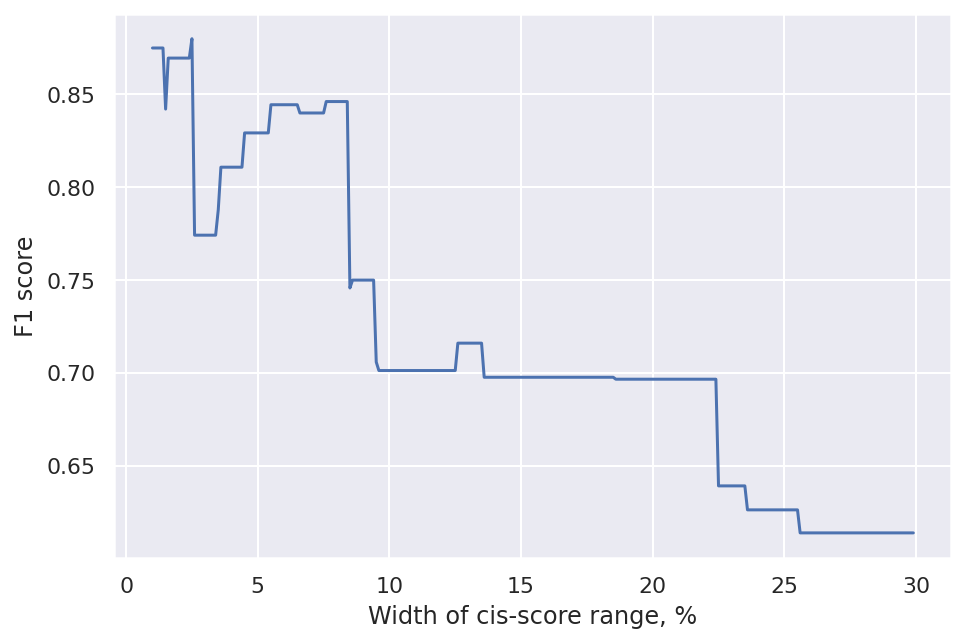

In [50]:
x = np.arange(1,30,0.1)
# x = np.arange(10,15,0.1)
f1 = []
pr_arr = []
rc_arr = []
for d in x:
    mask = (tmp_cis_fp['cis'] < (xx_cis_mean+xy_cis_mean)/2 + d) & (tmp_cis_fp['cis'] > (xx_cis_mean+xy_cis_mean)/2 - d)
    tp = tmp_cis_fp[mask]['tp'].sum()
    fp = tmp_cis_fp[mask]['fp'].sum()
    fn = tmp_cis_fp[mask]['fn'].sum()
    pr = tp/(tp+fp)
    pr_arr += [pr]
    rc = tp/(tp+fn)
    rc_arr += [rc]
    f1 += [2*pr*rc/(pr+rc)]

fig, ax = plt.subplots(figsize=(7.5,5))
ax.set_xlabel("Width of cis-score range, %")
ax.set_ylabel("F1 score")
sns.lineplot(x=x, y=f1, ax=ax)
plt.savefig("/mnt/a/!PhD/ExoC article/F1_score.svg", format="svg")

In [44]:
# cis_d = x[np.array(f1).argmax()]
cis_d = 8.3
mask = (tmp_cis_fp['cis'] < (xx_cis_mean+xy_cis_mean)/2 + cis_d) & (tmp_cis_fp['cis'] > (xx_cis_mean+xy_cis_mean)/2 - cis_d)
print(f"clean samples: {mask.sum()}, whole samples: {len(mask)}, filtered: {(~mask).sum()}\n{(xx_cis_mean+xy_cis_mean)/2 - cis_d}% < CIS < {(xx_cis_mean+xy_cis_mean)/2 + cis_d}")

clean samples: 48, whole samples: 66, filtered: 18
58.2471% < CIS < 74.8471


In [45]:
n_trans_valid = 0
tp = tmp_cis_fp[mask]['tp'].sum() + n_trans_valid
fp = tmp_cis_fp[mask]['fp'].sum() - n_trans_valid
fn = tmp_cis_fp[mask]['fn'].sum()
pr = tp/(tp+fp)
rc = tp/(tp+fn)
print(f'TP: {tp}, FP: {fp}, FN: {fn}\nPrecision: {pr}, Recall: {rc}\nF1: {2*pr*rc/(pr+rc)}\nN_samples: {mask.sum()}')

TP: 22, FP: 8, FN: 0
Precision: 0.7333333333333333, Recall: 1.0
F1: 0.846153846153846
N_samples: 48


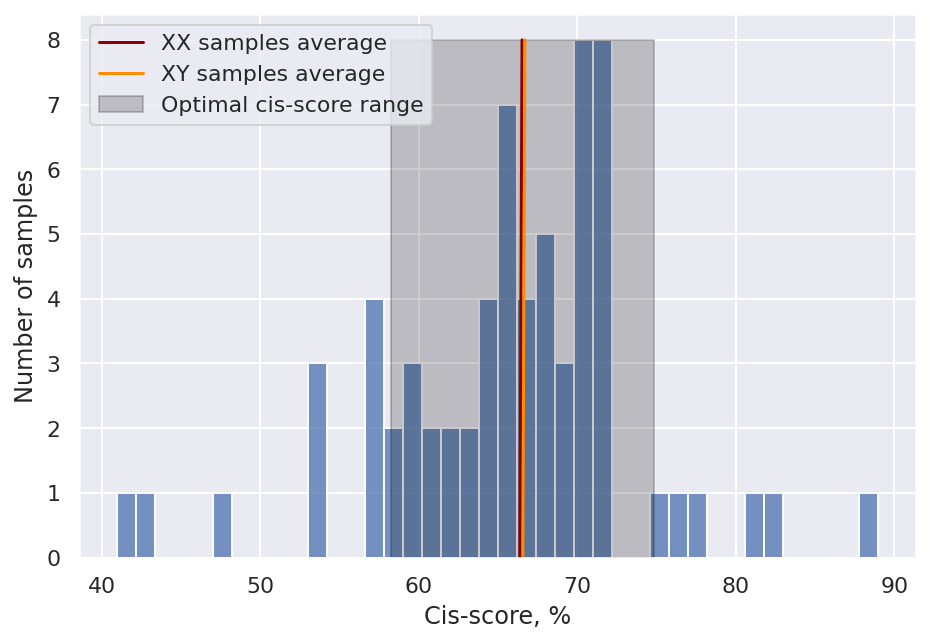

In [51]:
fig, ax = plt.subplots(figsize=(7.5,5))
sns.histplot(
    tmp_cis_fp['cis'],
    bins=40,
    ax=ax,
    legend=False,
)
sns.lineplot(x=[xx_cis_mean*0.999, xx_cis_mean*1.001], y=[0, 8], color='darkred', ax=ax)
sns.lineplot(x=[xy_cis_mean*0.999, xy_cis_mean*1.001], y=[0, 8], color='darkorange', ax=ax)

ax.fill_betweenx(
    [0,8],
    (xx_cis_mean+xy_cis_mean)/2 + cis_d,
    (xx_cis_mean+xy_cis_mean)/2 - cis_d,
    interpolate=True, alpha=0.2,
    color = 'black',
)

ax.set_xlabel("Cis-score, %")
ax.set_ylabel("Number of samples")
ax.legend(['XX samples average', 'XY samples average', 'Optimal cis-score range'])
plt.savefig("/mnt/a/!PhD/ExoC article/Cis_trans_hist.svg", format="svg")

In [234]:
tmp_cis_fp[~mask]

,names,cis,enrich,batch,fp,tp,fn
0,P137,41,70.47,7,2,0,0
1,P124,43,54.97,6,2,0,0
2,P42,48,83.99,2,1,1,0
3,P37,53,92.57,1,1,0,0
4,P43,53,79.51,2,2,1,0
5,P69,54,81.03,3,0,2,0
6,P112,57,65.07,5,0,0,0
7,P38,57,93.38,1,2,0,0
8,P44,57,76.21,3,0,1,0
9,P63,57,76.69,3,1,2,0


In [207]:
answer_base = data_base[data_base['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_base: answer_base[pat_id] = list(answer_base[pat_id])
answer_line = data_line[data_line['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_line: answer_line[pat_id] = list(answer_line[pat_id])
answer = answer_base.copy()
for pat_id in answer_line:
    if pat_id in answer:
        answer[pat_id] = list(set(answer_line[pat_id] + answer[pat_id]))
    else:
        answer[pat_id] = answer_line[pat_id]

for pat_id in artifacts_dict_base:
    if pat_id.split('_')[-1] in black_list:
        if pat_id in answer:
            print(pat_id)
            print(sorted(answer[pat_id]))
            print(sorted(artifacts_dict_base[pat_id]['translocation'] + artifacts_dict_base[pat_id]['rob']))

        else:
            print(pat_id)
            print('----')
            print(sorted(artifacts_dict_base[pat_id]['translocation']))

        print()

s90_P26
----
[]

s93_P35
['chr9-chrX']
[]

s95_P37
['chr9-chr17']
[]

s96_P38
['chr11-chr19', 'chr14-chr19']
[]

s98_P39
----
[]

s169_P70
['chr16-chr22']
[]

s170_P71
----
[]

s172_P73
----
[]

s174_P78
----
[]

s181_iP65
----
[]

s191_P109
----
[]

s194_P114
----
[]

s199_P115
----
[]

s204_P122
----
[]

s205_P123
----
[]

s99_TAF3
['chr1-chr19', 'chr11-chr17', 'chr11-chr19', 'chr13-chr19', 'chr14-chr17', 'chr16-chr19', 'chr17-chr21', 'chr18-chr19', 'chr19-chrX', 'chr21-chr22', 'chr3-chr17', 'chr3-chr19', 'chr4-chr17', 'chr4-chr19', 'chr4-chr22', 'chr5-chr17', 'chr5-chr19', 'chr6-chr17', 'chr6-chr19', 'chr8-chr19', 'chr9-chr19']
[]

s100_TAF4
['chr11-chr19', 'chr13-chr19', 'chr18-chr19', 'chr19-chr21', 'chr3-chr19', 'chr4-chr19', 'chr5-chr17', 'chr5-chr19', 'chr6-chr19', 'chr8-chr19']
[]

s101_TAF9
['chr14-chr17', 'chr4-chr19', 'chr5-chr17', 'chr5-chr19']
[]

s207_P125
----
[]

s209_P131
----
[]

s211_P133
----
[]

s215_P139
----
[]

s206_P124
['chr11-chr19', 'chr2-chr17', 'chr3-chr1

# Mir_model analysis

In [2]:
workdir = "/mnt/a/!Work/tmp/Exoc/mir_model/accurasy_test/"

In [3]:
trans_df = pd.read_csv(workdir + 'true_trans/all_translocations.csv')
trans_df['x_interval'] = trans_df['x_interval'].apply(lambda x: interval.from_str(x))
trans_df['y_interval'] = trans_df['y_interval'].apply(lambda x: interval.from_str(x))
trans_df

,name,n,chr1,x1,x2,chr2,y1,y2,color,size,x_interval,y_interval,counts,chr_pair,bin_cov,shoulders
0,tmf,1,chr22,30804000,30816000,chr12,107788000,107836000,"0,0,0",12000,"[7701.0,7704.0)","[26947.0,26959.0)",0,chr12-chr22,5670,False
1,tmf,1,chr5,62836000,62864000,chr19,20236000,20348000,"0,0,0",28000,"[15709.0,15716.0)","[5059.0,5087.0)",0,chr5-chr19,809,False
2,tmf,2,chr18,9788000,9884000,chr9,132068000,132452000,"0,0,0",96000,"[2447.0,2471.0)","[33017.0,33113.0)",74,chr9-chr18,537,False
3,tmf,2,chr21,42716000,43484000,chr6,164864000,167936000,"0,0,0",768000,"[10679.0,10871.0)","[41216.0,41984.0)",500,chr6-chr21,4802,False
4,tmf,3,chr13,16200000,17096000,chr19,51632000,55216000,"0,0,0",896000,"[4050.0,4274.0)","[12908.0,13804.0)",0,chr13-chr19,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,tmf,398,chr8,92792000,93688000,chr21,25760000,29344000,"0,0,0",896000,"[23198.0,23422.0)","[6440.0,7336.0)",305,chr8-chr21,116,False
796,tmf,399,chr16,1656000,2552000,chr15,8092000,11676000,"0,0,0",896000,"[414.0,638.0)","[2023.0,2919.0)",0,chr15-chr16,3312,False
797,tmf,399,chr15,9736000,10504000,chr1,65704000,68776000,"0,0,0",768000,"[2434.0,2626.0)","[16426.0,17194.0)",0,chr1-chr15,0,False
798,tmf,400,chr9,82476000,141213431,chr8,0,146364022,"0,0,0",58737431,"[20619.0,35303.0)","[0.0,36591.0)",28297,chr8-chr9,665,True


In [4]:
# trans_df['chr_pair'] = trans_df['chr1']+'_'+trans_df['chr2']
trans_df['chr_pair'] = trans_df[['chr1', 'chr2']].apply(lambda x: f'{x[0]}_{x[1]}' if int(x[0][3:])<int(x[1][3:]) else f'{x[1]}_{x[0]}', axis=1)
trans_df['pat_id'] = trans_df['name']+'_'+trans_df['n'].apply(lambda x: str(x))

In [463]:
%%time
all_stats_line = pd.DataFrame()
s4s = "-all_artifacts_line.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        tmp = pd.read_csv(workdir + file)
        tmp_mask = (tmp['counts_pat']>0) & (tmp['counts_control']>0)
        tmp = tmp[tmp_mask]
        tmp['pat_id'] = file.split('-')[0]
        
        tmp['x_interval'] = tmp['x_interval'].apply(lambda x: interval.from_str(x))
        tmp['y_interval'] = tmp['y_interval'].apply(lambda x: interval.from_str(x))
        
        tmp['real'] = tmp[['pat_id','from_chr','to_chr','x_interval']].apply(lambda x: 
                                        
                                len(trans_df[(trans_df['pat_id']==x[0])&
                                             (trans_df['chr1']==x[1])&
                                             (trans_df['chr2']==x[2])&
                                             (x[3]((trans_df['x_interval']*4e3).values) != None)]) > 0 \
#                                 or \
#                                 len(trans_df[(trans_df['pat_id']==x[0])&
#                                              (trans_df['chr1']==x[2])&
#                                              (trans_df['chr2']==x[1])&
#                                              (x[3]((trans_df['y_interval']*4e3).values) != None)]) > 0
                                                                         
                                                                             , axis=1)
        
        all_stats_line = all_stats_line.append(tmp, ignore_index=True)
        
# all_stats_line.sort_values('real', inplace=True)
all_stats_line['chr_pair'] = all_stats_line[['from_chr', 'to_chr']].apply(lambda x: f'{x[0]}_{x[1]}' if int(x[0][3:])<int(x[1][3:]) else f'{x[1]}_{x[0]}', axis=1)

CPU times: user 14.8 s, sys: 0 ns, total: 14.8 s
Wall time: 19.3 s


In [464]:
all_stats_line

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,real,chr_pair
0,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_1,False,chr2_chr17
1,256000,822.0,3900.0,chr8,chr6,288.0,292.0,5.0,"[73728000.0,75008000.0)",142.571954,484.0,584.0,"[123904000.0,149760000.0)",121.843753,tmf_10,False,chr6_chr8
2,256000,1875.0,4170.0,chr6,chr8,533.0,536.0,4.0,"[136448000.0,137472000.0)",347.793735,251.0,331.0,"[64256000.0,84992000.0)",166.705917,tmf_10,True,chr6_chr8
3,16000,83.0,175.0,chr8,chr6,4646.0,4649.0,4.0,"[74336000.0,74400000.0)",36.194032,8551.0,8631.0,"[136816000.0,138112000.0)",39.202229,tmf_10,False,chr6_chr8
4,16000,253.0,641.0,chr8,chr6,4657.0,4666.0,10.0,"[74512000.0,74672000.0)",94.171205,8444.0,8644.0,"[135104000.0,138320000.0)",79.832481,tmf_10,False,chr6_chr8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3437,16000,116.0,134.0,chr14,chr21,2640.0,2643.0,4.0,"[42240000.0,42304000.0)",77.192249,2531.0,2611.0,"[40496000.0,41792000.0)",41.154856,tmf_99,False,chr14_chr21
3438,4000,206.0,373.0,chr14,chr2,10588.0,10592.0,5.0,"[42352000.0,42372000.0)",107.643894,10583.0,10683.0,"[42332000.0,42736000.0)",57.787724,tmf_99,True,chr2_chr14
3439,4000,87.0,524.0,chr21,chr2,10142.0,10146.0,5.0,"[40568000.0,40588000.0)",9.496723,10652.0,10752.0,"[42608000.0,43012000.0)",23.482695,tmf_99,False,chr2_chr21
3440,4000,104.0,111.0,chr2,chr21,10651.0,10654.0,4.0,"[42604000.0,42620000.0)",73.743155,10165.0,10245.0,"[40660000.0,40984000.0)",48.481121,tmf_99,True,chr2_chr21


In [465]:
all_stats_line[all_stats_line['pat_id']=='tmf_170']

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,real,chr_pair
669,256000,4125.0,8091.0,chr18,chr16,79.0,82.0,4.0,"[20224000.0,21248000.0)",347.658309,298.0,378.0,"[76288000.0,97024000.0)",134.806183,tmf_170,True,chr16_chr18
670,256000,1886.0,7326.0,chr16,chr18,330.0,343.0,14.0,"[84480000.0,88064000.0)",347.678772,0.0,222.0,"[0.0,57088000.0)",348.122603,tmf_170,False,chr16_chr18
671,16000,258.0,363.0,chr13,chr14,3768.0,3771.0,4.0,"[60288000.0,60352000.0)",165.526843,6561.0,6641.0,"[104976000.0,106272000.0)",31.804628,tmf_170,True,chr13_chr14
672,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_170,False,chr2_chr17
673,16000,4229.0,8242.0,chr18,chr16,1268.0,1330.0,63.0,"[20288000.0,21296000.0)",347.654513,4779.0,6039.0,"[76464000.0,96640000.0)",64.146865,tmf_170,True,chr16_chr18
674,16000,156.0,476.0,chr16,chr18,5356.0,5364.0,9.0,"[85696000.0,85840000.0)",35.703325,1195.0,1375.0,"[19120000.0,22016000.0)",16.223299,tmf_170,False,chr16_chr18
675,16000,192.0,432.0,chr16,chr18,5369.0,5379.0,11.0,"[85904000.0,86080000.0)",63.228240,1176.0,1396.0,"[18816000.0,22352000.0)",24.789689,tmf_170,False,chr16_chr18
676,16000,122.0,239.0,chr16,chr18,5390.0,5398.0,9.0,"[86240000.0,86384000.0)",45.947158,1229.0,1409.0,"[19664000.0,22560000.0)",38.418984,tmf_170,False,chr16_chr18
677,16000,274.0,629.0,chr16,chr18,5403.0,5411.0,9.0,"[86448000.0,86592000.0)",88.626285,1235.0,1415.0,"[19760000.0,22656000.0)",36.134295,tmf_170,False,chr16_chr18
678,4000,258.0,356.0,chr13,chr14,15073.0,15087.0,15.0,"[60292000.0,60352000.0)",167.515777,26256.0,26556.0,"[105024000.0,106228000.0)",31.804628,tmf_170,True,chr13_chr14


In [466]:
%%time
tmp_line = all_stats_line.copy()
i = 0
while i < all_stats_line.shape[0]:
    if i >= tmp_line.shape[0]: break

    tmp_line_dot = tmp_line.iloc[i,:]
    tmp_line_interval = tmp_line_dot['x_interval']

    tmp_line_mask =~((tmp_line['pat_id'] == tmp_line_dot['pat_id']) *
                (tmp_line['from_chr'] == tmp_line_dot['from_chr']) *
                (tmp_line['to_chr'] == tmp_line_dot['to_chr']) *
                (tmp_line['x_interval'].apply(lambda x: x(tmp_line_interval) is not None) ) *
                (tmp_line['from_stat_binom']+tmp_line['to_stat_binom'] < tmp_line_dot['from_stat_binom']+tmp_line_dot['to_stat_binom']))
    self_cheker =((tmp_line['pat_id'] == tmp_line_dot['pat_id']) *
                  (tmp_line['from_chr'] == tmp_line_dot['from_chr']) *
                  (tmp_line['to_chr'] == tmp_line_dot['to_chr']) *
                  (tmp_line['x_interval'].apply(lambda x: x(tmp_line_interval) is not None) ) *
                  (tmp_line['from_stat_binom']+tmp_line['to_stat_binom'] > tmp_line_dot['from_stat_binom']+tmp_line_dot['to_stat_binom'])).sum() > 0

    if self_cheker > 0:
        i-=1
        tmp_line_mask[tmp_line_dot.name] = False
    
    tmp_line = tmp_line[tmp_line_mask]
    i+=1

KeyboardInterrupt: 

In [467]:
tmp_line[tmp_line['pat_id']=='tmf_170']

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,real,chr_pair
669,256000,4125.0,8091.0,chr18,chr16,79.0,82.0,4.0,"[20224000.0,21248000.0)",347.658309,298.0,378.0,"[76288000.0,97024000.0)",134.806183,tmf_170,True,chr16_chr18
670,256000,1886.0,7326.0,chr16,chr18,330.0,343.0,14.0,"[84480000.0,88064000.0)",347.678772,0.0,222.0,"[0.0,57088000.0)",348.122603,tmf_170,False,chr16_chr18
672,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_170,False,chr2_chr17
678,4000,258.0,356.0,chr13,chr14,15073.0,15087.0,15.0,"[60292000.0,60352000.0)",167.515777,26256.0,26556.0,"[105024000.0,106228000.0)",31.804628,tmf_170,True,chr13_chr14


In [468]:
mask1 = (tmp_line['pat_id'].apply(lambda x: ['shoulder', 'simple'][x in list(trans_df[~trans_df['shoulders']]['pat_id'])])).values
fig = px.scatter(tmp_line, 
                 x = np.log10(abs(tmp_line['counts_pat'])),
                 y = 'from_stat_binom',
                 hover_data = ['pat_id', 'from_chr', 'to_chr'],
                 color = 'real',
                 symbol = mask1,
                )
x = np.linspace(1.5,3.4,100)
k = 1.73
fig.add_trace(go.Scatter(
    x = x,
    y = np.exp(k*x),
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [139]:
all_stats_line['real'].sum()

1774

In [140]:
all_stats_line[~all_stats_line['real']]['chr_pair'].value_counts()

chr2_chr17     395
chr12_chr19     36
chr17_chr20     35
chr11_chr19     34
chr11_chr16     31
              ... 
chr11_chr14      1
chr11_chr17      1
chr6_chr16       1
chr2_chr15       1
chr2_chr12       1
Name: chr_pair, Length: 167, dtype: int64

In [141]:
tmp_line

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,real,chr_pair
0,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_1,False,chr2_chr17
1,256000,822.0,3900.0,chr8,chr6,288.0,292.0,5.0,"[73728000.0,75008000.0)",142.571954,484.0,584.0,"[123904000.0,149760000.0)",121.843753,tmf_10,False,chr6_chr8
2,256000,1875.0,4170.0,chr6,chr8,533.0,536.0,4.0,"[136448000.0,137472000.0)",347.793735,251.0,331.0,"[64256000.0,84992000.0)",166.705917,tmf_10,True,chr6_chr8
6,16000,403.0,1338.0,chr20,chr2,2016.0,2023.0,8.0,"[32256000.0,32384000.0)",128.694598,966.0,1126.0,"[15456000.0,18032000.0)",16.957156,tmf_10,True,chr2_chr20
7,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_10,False,chr2_chr17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3434,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_99,False,chr2_chr17
3435,16000,286.0,498.0,chr14,chr2,2647.0,2651.0,5.0,"[42352000.0,42432000.0)",153.939481,2608.0,2708.0,"[41728000.0,43344000.0)",89.926590,tmf_99,True,chr2_chr14
3436,16000,45.0,60.0,chr14,chr21,2627.0,2630.0,4.0,"[42032000.0,42096000.0)",27.283190,2568.0,2648.0,"[41088000.0,42384000.0)",7.209594,tmf_99,False,chr14_chr21
3437,16000,116.0,134.0,chr14,chr21,2640.0,2643.0,4.0,"[42240000.0,42304000.0)",77.192249,2531.0,2611.0,"[40496000.0,41792000.0)",41.154856,tmf_99,False,chr14_chr21


In [142]:
roc_stats = pd.DataFrame([], columns=['k', 'b', 'tp', 'tn', 'fp', 'fn'])
for k in np.linspace(1.0,2.0,100):
    for b in np.linspace(0.0,0.5,11):
        roc_stats_tmp_line = pd.Series()
        roc_stats_tmp_line['k'] = k
        roc_stats_tmp_line['b'] = b
        predicted = (np.exp(k*np.log10(tmp_line['counts_pat'])-b) < tmp_line['from_stat_binom']) | (tmp_line['from_stat_binom'] > 330)
        true_ans = tmp_line['real'] & (~(mask1=='shoulder'))
        roc_stats_tmp_line['tp'] = ((predicted==true_ans) & (predicted)).sum()
        roc_stats_tmp_line['fp'] = ((predicted!=true_ans) & (predicted)).sum() - 184
        roc_stats_tmp_line['fn'] = ((predicted!=true_ans) & (~predicted)).sum()
        roc_stats_tmp_line['tn'] = ((predicted==true_ans) & (~predicted)).sum()
        
        roc_stats = roc_stats.append(roc_stats_tmp_line, ignore_index=True)
del(roc_stats_tmp_line)

roc_stats['precision'] = roc_stats['tp']/(roc_stats['tp']+roc_stats['fp'])
roc_stats['recall'] = roc_stats['tp']/(roc_stats['tp']+roc_stats['fn'])

In [143]:
roc_stats

,k,b,tp,tn,fp,fn,precision,recall
0,1.0,0.00,373.0,410.0,735.0,0.0,0.336643,1.000000
1,1.0,0.05,373.0,409.0,736.0,0.0,0.336339,1.000000
2,1.0,0.10,373.0,407.0,738.0,0.0,0.335734,1.000000
3,1.0,0.15,373.0,404.0,741.0,0.0,0.334829,1.000000
4,1.0,0.20,373.0,403.0,742.0,0.0,0.334529,1.000000
...,...,...,...,...,...,...,...,...
1095,2.0,0.30,325.0,1094.0,51.0,48.0,0.864362,0.871314
1096,2.0,0.35,337.0,1086.0,59.0,36.0,0.851010,0.903485
1097,2.0,0.40,344.0,1081.0,64.0,29.0,0.843137,0.922252
1098,2.0,0.45,352.0,1072.0,73.0,21.0,0.828235,0.943700


In [144]:
fig = px.scatter(roc_stats, 
                 x = 'precision',
                 y = 'recall',
                 hover_data = ['k', 'b', 'tp', 'fp', 'fn'],
                 color = 'k',
                 animation_frame = 'b',
                )


fig.update_layout(autosize=False, width=1000, height=800)
fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [145]:
data = pd.DataFrame()
s4s = "-all_artifacts.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        tmp = pd.read_csv(workdir + file)
        tmp['pat_id'] = file.split('-')[0]
        data = data.append(tmp, ignore_index=True)
# data = pd.read_csv(workdir + f'full_table')
        
data['x_interval'] = data['x_interval'].apply(interval.from_str) * data['resolution']
data['y_interval'] = data['y_interval'].apply(interval.from_str) * data['resolution']

In [146]:
data = data[(data['prob'] > 0) * (data['chrX'] != data['chrY'])]
data['chr_pair'] = data['chrX']+'_'+data['chrY']
data['true_pair'] = data[['pat_id','chr_pair']].apply(lambda x: sum((trans_df['n']==int(x[0][4:])) * (trans_df['chr_pair']==x[1]))>0, axis=1)

In [147]:
data

,x,y,chrX,chrY,prob,x_lim,y_lim,s_init,sx,sy,...,pat_sum,control_sum,resolution,mosaik,size,x_interval,y_interval,pat_id,chr_pair,true_pair
0,9071,5860,chr1,chr12,4.030218,3,6,4,-1,1,...,9,346,16000,1.0,3,"(145088000.0,145136000.0]","[93760000.0,93856000.0)",tmf_1,chr1_chr12,False
1,3693,2003,chr1,chr2,3.737537,3,5,4,1,-1,...,9,204,16000,1.0,3,"[59088000.0,59136000.0)","(31968000.0,32048000.0]",tmf_1,chr1_chr2,False
2,6664,1260,chr14,chr15,1.243527,4,3,4,1,1,...,6,104,16000,1.0,3,"[106624000.0,106688000.0)","[20160000.0,20208000.0)",tmf_1,chr14_chr15,False
3,33254,11325,chr2,chr17,33.545191,4,30,0,1,-1,...,123,2759,4000,1.0,4,"[133016000.0,133032000.0)","(45180000.0,45300000.0]",tmf_1,chr2_chr17,False
4,27579,34149,chr5,chr6,7.687260,11,2,0,-1,1,...,22,734,4000,1.0,2,"(110272000.0,110316000.0]","[136596000.0,136604000.0)",tmf_1,chr5_chr6,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17484,22989,30972,chr2,chr12,0.805195,9,1,2,-1,-1,...,3,4,4000,1.0,1,"(91920000.0,91956000.0]","(123884000.0,123888000.0]",tmf_99,chr2_chr12,False
17485,11019,10466,chr13,chr15,0.638517,13,2,4,-1,-1,...,8,75,4000,1.0,2,"(44024000.0,44076000.0]","(41856000.0,41864000.0]",tmf_99,chr13_chr15,False
17486,26617,5616,chr14,chr15,0.618008,7,1,2,1,-1,...,3,6,4000,1.0,1,"[106468000.0,106496000.0)","(22460000.0,22464000.0]",tmf_99,chr14_chr15,False
17487,30371,5624,chr1,chr19,0.485930,1,3,2,-1,-1,...,4,60,4000,1.0,1,"(121480000.0,121484000.0]","(22484000.0,22496000.0]",tmf_99,chr1_chr19,False


In [148]:
data['intersect'] = False
res=4000
for i in range(data.shape[0]):
    tmp_dot = data[['pat_id','chr_pair','chrX','chrY','x_interval','y_interval','resolution']].iloc[i,:]
    mask = (trans_df['pat_id']==tmp_dot['pat_id']) * \
            ((trans_df['chr_pair']==f"{tmp_dot['chrX']}_{tmp_dot['chrY']}") | \
            (trans_df['chr_pair']==f"{tmp_dot['chrY']}_{tmp_dot['chrX']}"))
    

    if len(trans_df[mask])>0:
        tmp_dot_inter = trans_df[mask][['x_interval', 'y_interval','chr1','chr2']].apply(lambda x:
                                                                                      
                                                (x[0](tmp_dot['x_interval']*(1/res)) is not None) * \
                                                (x[1](tmp_dot['y_interval']*(1/res)) is not None)\
                                                if x[2]==tmp_dot['chrX'] and x[3]==tmp_dot['chrY'] else\
                                                (x[0](tmp_dot['y_interval']*(1/res)) is not None) * \
                                                (x[1](tmp_dot['x_interval']*(1/res)) is not None)                                      
                                                                        
                                                                        , axis=1)
        data.loc[i,'intersect'] = tmp_dot_inter.sum()>0

In [149]:
data['intersect'].sum()

793

In [151]:
# mask = data['pat_id'].apply(lambda x: ['shoulder', 'simple'][x in list(trans_df[~trans_df['shoulders']]['pat_id'])])

fig = px.scatter(data, 
                 x = np.log10(abs(data['pat_sum'])),
                 y = np.log10(abs(data['prob'])),
#                  symbol = mask,
                 symbol = 'resolution',
#                  color = 'size',
#                  range_color = [3.0,6.0],
                 hover_data = ['pat_id', 'chrX', 'chrY'],
                 color = 'intersect',
                )
x = np.linspace(0.5,4.5,100)
k_base = (2.3 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
fig.add_trace(go.Scatter(
    x = x,
    y = k_base*x+b_base,
#     color='black'
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [154]:
data[~data['intersect']]['chr_pair'].value_counts()

chr1_chr19     3168
chr1_chr5      1582
chr14_chr15    1577
chr2_chr21     1204
chr13_chr15    1186
               ... 
chr5_chr9         1
chr7_chr22        1
chr1_chr7         1
chr12_chr13       1
chr8_chr20        1
Name: chr_pair, Length: 137, dtype: int64

In [155]:
data[data['true_pair'] & ~data['intersect']].head(20)

,x,y,chrX,chrY,prob,x_lim,y_lim,s_init,sx,sy,...,resolution,mosaik,size,x_interval,y_interval,pat_id,chr_pair,true_pair,intersect,base_meth_found
83,33255,6547,chr2,chr20,0.164905,3,1,4,-1,-1,...,4000,1.0,1,"(133008000.0,133020000.0]","(26184000.0,26188000.0]",tmf_10,chr2_chr20,True,False,0
185,22271,12752,chr15,chr22,4.428341,3,1,0,-1,-1,...,4000,1.0,1,"(89072000.0,89084000.0]","(51004000.0,51008000.0]",tmf_102,chr15_chr22,True,False,0
187,22296,12754,chr15,chr22,3.108676,1,3,0,-1,-1,...,4000,1.0,1,"(89180000.0,89184000.0]","(51004000.0,51016000.0]",tmf_102,chr15_chr22,True,False,0
312,25155,10716,chr14,chr15,3.268633,5,1,0,-1,-1,...,4000,1.0,1,"(100600000.0,100620000.0]","(42860000.0,42864000.0]",tmf_105,chr14_chr15,True,False,0
313,25600,10716,chr14,chr15,2.970831,4,1,0,1,-1,...,4000,1.0,1,"[102400000.0,102416000.0)","(42860000.0,42864000.0]",tmf_105,chr14_chr15,True,False,0
315,26611,5616,chr14,chr15,2.314132,1,5,1,-1,1,...,4000,1.0,1,"(106440000.0,106444000.0]","[22464000.0,22484000.0)",tmf_105,chr14_chr15,True,False,0
323,26617,5618,chr14,chr15,1.524489,7,1,2,1,-1,...,4000,1.0,1,"[106468000.0,106496000.0)","(22468000.0,22472000.0]",tmf_105,chr14_chr15,True,False,0
335,26673,5043,chr14,chr15,1.137753,19,1,4,-1,-1,...,4000,1.0,1,"(106616000.0,106692000.0]","(20168000.0,20172000.0]",tmf_105,chr14_chr15,True,False,0
337,26589,5618,chr14,chr15,1.024281,4,1,2,1,-1,...,4000,1.0,1,"[106356000.0,106372000.0)","(22468000.0,22472000.0]",tmf_105,chr14_chr15,True,False,0
338,26592,5618,chr14,chr15,1.024281,4,1,2,-1,-1,...,4000,1.0,1,"(106352000.0,106368000.0]","(22468000.0,22472000.0]",tmf_105,chr14_chr15,True,False,0


In [167]:
k = 1.74
tmp_line['line_meth_found'] = ((np.exp(k*np.log10(tmp_line['counts_pat'])) < tmp_line['from_stat_binom']) | (tmp_line['from_stat_binom'] > 330)) * 1
data['base_meth_found'] = 1 * (data['resolution'] >= 256e3)
trans_df['true_answer'] = 1
trans_df['complex_trans'] = 1 * (trans_df['pat_id'].apply(lambda x: int(x.split('_')[-1]) in [3+4*n for n in range(101)]))
trans_df['counts_near_trans'] = 1 * (trans_df['counts'] > 0)

complete_stats = pd.DataFrame().append(trans_df[['pat_id', 'chr_pair', 'true_answer', 'complex_trans', 'counts_near_trans', 'size']], ignore_index=True)
complete_stats = complete_stats.append(data[['pat_id', 'chr_pair', 'base_meth_found']], ignore_index=True)
complete_stats = complete_stats.append(tmp_line[['pat_id', 'chr_pair', 'line_meth_found']], ignore_index=True)

complete_stats = complete_stats.groupby(['pat_id', 'chr_pair']).sum()
complete_stats

true_answer  complex_trans  counts_near_trans      size  \
pat_id chr_pair                                                               
tmf_1  chr12_chr22          1.0            0.0                0.0   12000.0   
       chr13_chr15          0.0            0.0                0.0       0.0   
       chr14_chr15          0.0            0.0                0.0       0.0   
       chr18_chr22          0.0            0.0                0.0       0.0   
       chr1_chr10           0.0            0.0                0.0       0.0   
...                         ...            ...                ...       ...   
tmf_99 chr2_chr17           0.0            0.0                0.0       0.0   
       chr2_chr20           0.0            0.0                0.0       0.0   
       chr2_chr21           1.0            1.0                1.0  768000.0   
       chr4_chr8            0.0            0.0                0.0       0.0   
       chr5_chr6            0.0            0.0                0.0       0.0   

                    base_meth_found  line_meth_found  
pat_id chr_pair                                       
tmf_1  chr12_chr22              0.0              0.0  
       chr13_chr15              0.0              0.0  
       chr14_chr15              0.0              0.0  
       chr18_chr22              0.0              0.0  
       chr1_chr10               0.0              0.0  
...                             ...              ...  
tmf_99 chr2_chr17               0.0              0.0  
       chr2_chr20               0.0              0.0  
       chr2_chr21               0.0              1.0  
       chr4_chr8                0.0              0.0  
       chr5_chr6                0.0              0.0  

[7512 rows x 6 columns]

In [179]:
not_complex_mask = (complete_stats['complex_trans'] == 0) #& (complete_stats['counts_near_trans'] > 0)
trans_slice = (complete_stats[not_complex_mask]['true_answer'] > 0)

ans = (complete_stats[not_complex_mask]['base_meth_found'] + complete_stats[not_complex_mask]['line_meth_found']) > 0
tp = (ans & trans_slice).sum()
fp = (ans & ~trans_slice).sum()
fn = (~ans & trans_slice).sum()

print('ALL')
print(f'TP: {tp}; FP: {fp}; FN: {fn}')
print(f'Precision: {tp/(tp+fp)}; Recall: {tp/(tp+fn)}')
print('---------------------')


ans = (complete_stats[not_complex_mask]['base_meth_found']) > 0
tp = (ans & trans_slice).sum()
fp = (ans & ~trans_slice).sum()
fn = (~ans & trans_slice).sum()

print('Base only')
print(f'TP: {tp}; FP: {fp}; FN: {fn}')
print(f'Precision: {tp/(tp+fp)}; Recall: {tp/(tp+fn)}')
print('---------------------')


ans = (complete_stats[not_complex_mask]['line_meth_found']) > 0
tp = (ans & trans_slice).sum()
fp = (ans & ~trans_slice).sum()
fn = (~ans & trans_slice).sum()

print('Line only')
print(f'TP: {tp}; FP: {fp}; FN: {fn}')
print(f'Precision: {tp/(tp+fp)}; Recall: {tp/(tp+fn)}')
print('---------------------')

ALL
TP: 279; FP: 80; FN: 221
Precision: 0.7771587743732591; Recall: 0.558
---------------------
Base only
TP: 171; FP: 34; FN: 329
Precision: 0.8341463414634146; Recall: 0.342
---------------------
Line only
TP: 233; FP: 80; FN: 267
Precision: 0.744408945686901; Recall: 0.466
---------------------


<AxesSubplot:xlabel='size', ylabel='Count'>

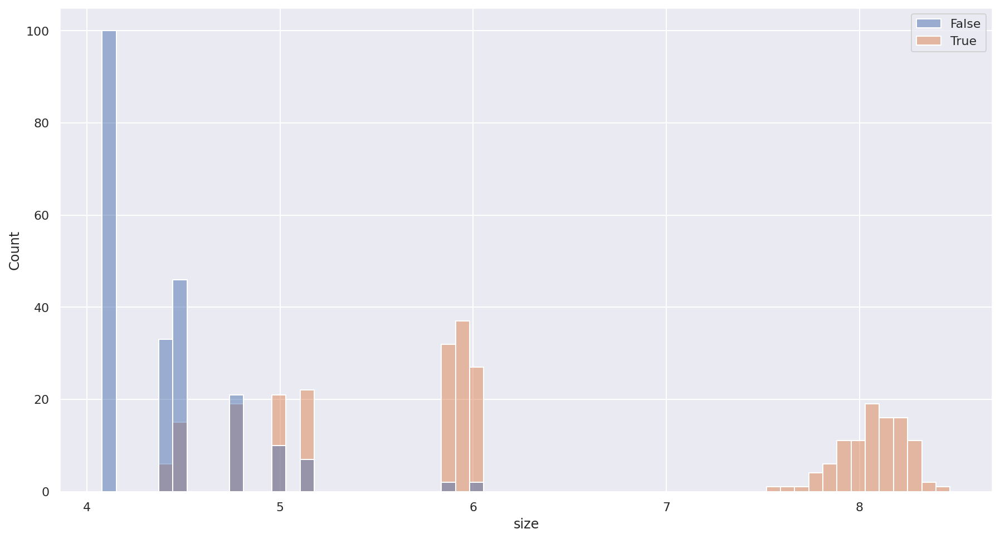

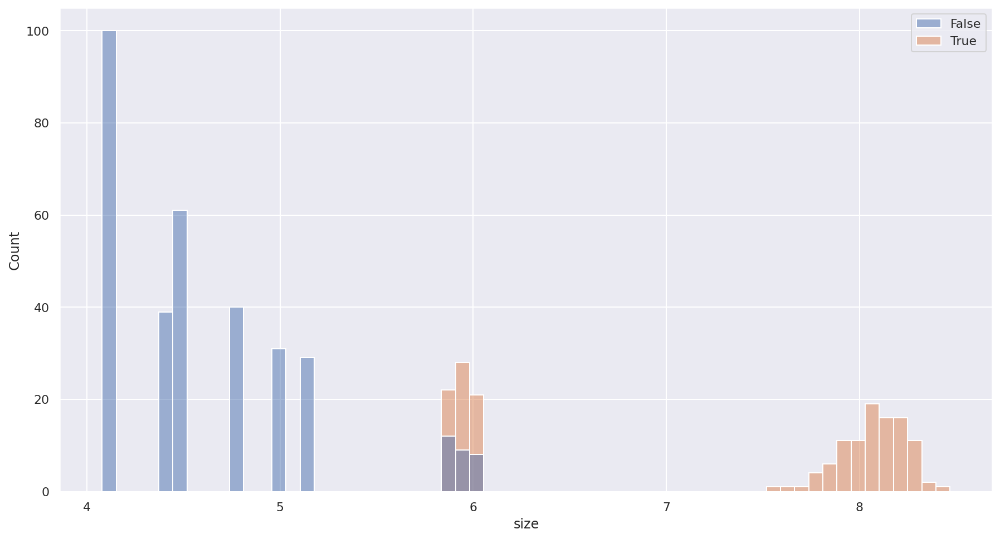

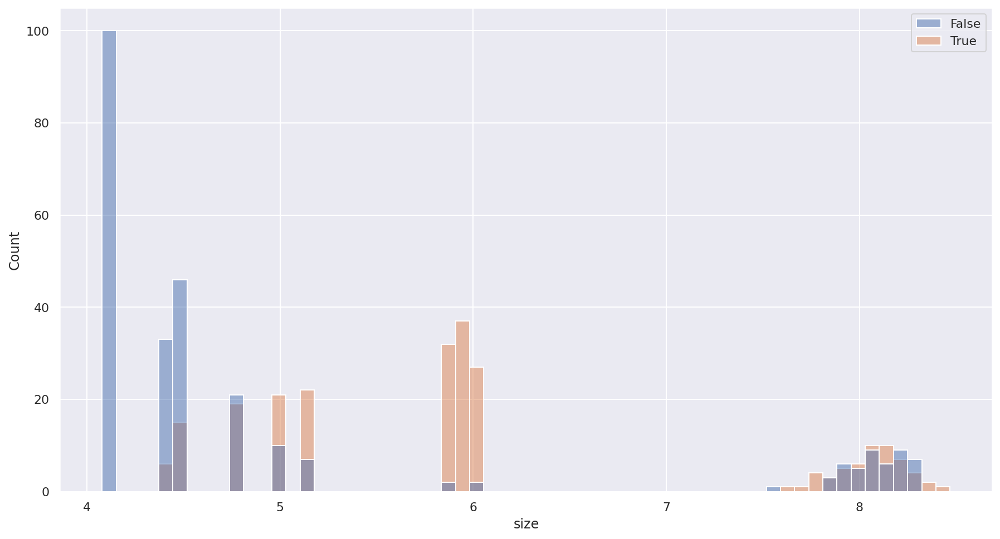

In [180]:
mask = (complete_stats['size'] > 0) & (complete_stats['complex_trans']==0.0) #& (complete_stats['counts_near_trans'] > 0)
ans = ((complete_stats[mask]['base_meth_found'] + complete_stats[mask]['line_meth_found']) > 0).values
plt.figure(figsize=(15,8))
sns.histplot(
             x = np.log10(complete_stats[mask]['size']),
             hue = ans,
            bins = 60,
                )

ans = ((complete_stats[mask]['base_meth_found']) > 0).values
plt.figure(figsize=(15,8))
sns.histplot(
             x = np.log10(complete_stats[mask]['size']),
             hue = ans,
            bins = 60,
                )

ans = ((complete_stats[mask]['line_meth_found']) > 0).values
plt.figure(figsize=(15,8))
sns.histplot(
             x = np.log10(complete_stats[mask]['size']),
             hue = ans,
            bins = 60,
                )

In [158]:
complete_stats[(complete_stats['size'] > 10**5.5) & 
               (complete_stats['size'] < 10**6.5) & 
               ~((complete_stats['base_meth_found'] + complete_stats['line_meth_found']) > 0) & 
               (complete_stats['complex_trans']==0.0)]

,,true_answer,complex_trans,counts_near_trans,size,base_meth_found,line_meth_found
pat_id,chr_pair,,,,,,
tmf_226,chr2_chr8,1.0,0.0,0.0,1024000.0,0.0,0.0
tmf_326,chr18_chr21,1.0,0.0,1.0,1024000.0,0.0,0.0
tmf_350,chr14_chr16,1.0,0.0,1.0,768000.0,0.0,0.0
tmf_82,chr3_chr22,1.0,0.0,0.0,768000.0,0.0,0.0


In [32]:
all_stats_line[all_stats_line['pat_id']=='tmf_326'] 

,resolution,counts_pat,counts_control,from_chr,to_chr,from_start,from_end,size,x_interval,from_stat_binom,to_start,to_end,y_interval,to_stat_binom,pat_id,real,chr_pair
1305,16000,145.0,3381.0,chr17,chr2,2826.0,2831.0,6.0,"[45216000.0,45312000.0)",5.080788,8253.0,8373.0,"[132048000.0,133984000.0)",12.023465,tmf_326,False,chr2_chr17


In [33]:
data[data['pat_id']=='tmf_326']

,x,y,chrX,chrY,prob,x_lim,y_lim,s_init,sx,sy,...,resolution,mosaik,size,x_interval,y_interval,pat_id,chr_pair,true_pair,intersect,base_meth_found
7777,6664,1260,chr14,chr15,1.162158,3,4,4,1,1,...,16000,1.0,3,"[106624000.0,106672000.0)","[20160000.0,20224000.0)",tmf_326,chr14_chr15,False,False,0
7778,3693,2003,chr1,chr2,3.645711,3,5,4,1,-1,...,16000,1.0,3,"[59088000.0,59136000.0)","(31968000.0,32048000.0]",tmf_326,chr1_chr2,False,False,0
7779,9071,5860,chr1,chr12,3.995234,3,6,4,-1,1,...,16000,1.0,3,"(145088000.0,145136000.0]","[93760000.0,93856000.0)",tmf_326,chr1_chr12,False,False,0
7780,30371,18945,chr1,chr3,0.132317,1,3,3,-1,1,...,4000,1.0,1,"(121480000.0,121484000.0]","[75780000.0,75792000.0)",tmf_326,chr1_chr3,False,False,0
7781,30371,5624,chr1,chr19,0.475018,1,3,2,-1,-1,...,4000,1.0,1,"(121480000.0,121484000.0]","(22484000.0,22496000.0]",tmf_326,chr1_chr19,False,False,0
7782,11018,10466,chr13,chr15,0.555728,12,2,4,-1,-1,...,4000,1.0,2,"(44024000.0,44072000.0]","(41856000.0,41864000.0]",tmf_326,chr13_chr15,False,False,0
7783,26617,5616,chr14,chr15,0.558996,7,1,2,1,-1,...,4000,1.0,1,"[106468000.0,106496000.0)","(22460000.0,22464000.0]",tmf_326,chr14_chr15,False,False,0
7784,17164,31668,chr1,chr10,0.824667,1,5,2,-1,-1,...,4000,1.0,1,"(68652000.0,68656000.0]","(126652000.0,126672000.0]",tmf_326,chr1_chr10,False,False,0
7785,17156,24476,chr1,chr5,0.915786,2,4,4,1,1,...,4000,1.0,2,"[68624000.0,68632000.0)","[97904000.0,97920000.0)",tmf_326,chr1_chr5,False,False,0
7786,33254,6547,chr2,chr20,0.924907,3,2,2,1,1,...,4000,1.0,2,"[133016000.0,133028000.0)","[26188000.0,26196000.0)",tmf_326,chr2_chr20,False,False,0


In [70]:
a = sparse.coo_matrix(([1,2,3], ([1,1,2],[4,3,4])), shape=(5,5))
b = a.tocsr()
b[1:3,2:].toarray()

array([[0, 2, 1],
       [0, 0, 3]])

In [75]:
c1 = interval(0.8, 2.9, 'left')
c2 = interval(2.0, 5, 'left')
(b[c1.to_slice(),c2.to_slice()]+10).toarray()

NotImplementedError: adding a nonzero scalar to a sparse matrix is not supported

In [69]:
a = np.array([1,2,3,4,5])
c1 = interval(0.8, 2.9, 'left')
c2 = interval(4.5, 10.0, 'left')
b = pd.DataFrame({'A': [c1, c2]})
b['A'].apply(lambda x: x(a)).values.sum(axis=0)

array([ True,  True, False, False,  True])

In [68]:
b

,A
0,"[0.8,2.9)"
1,"[2.0,5)"


In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [4]:
data = pd.read_csv('/mnt/a/!Work/tmp/Exoc/KAPA_HyperExome.capture.bed', header=None, sep=' ')

In [5]:
data

,0,1,2
0,chr1,65509,65629
1,chr1,69027,70017
2,chr1,367650,368606
3,chr1,621086,622042
4,chr1,859801,860337
...,...,...,...
208278,chrY,27184948,27185068
208279,chrY,27187913,27188033
208280,chrY,27190055,27190175
208281,chrY,27768580,27770220


/mnt/a/Python/cooler_env/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


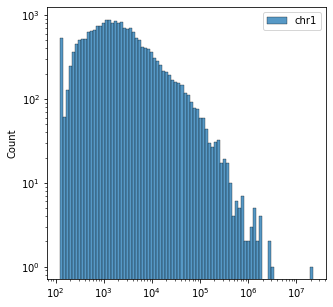

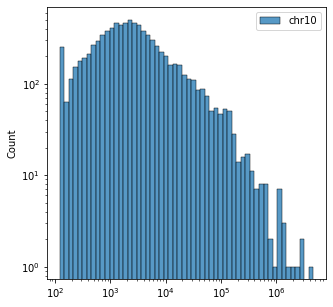

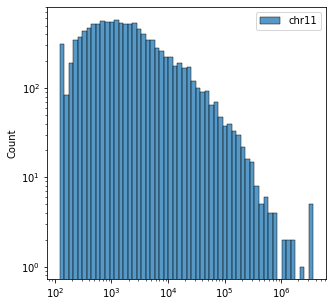

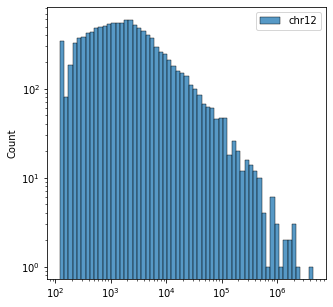

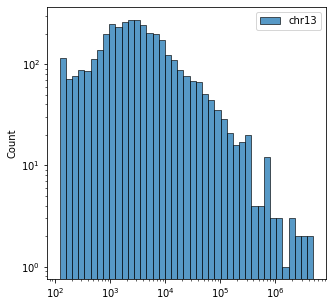

...

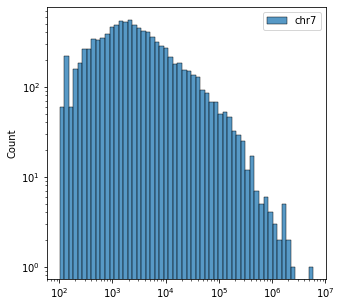

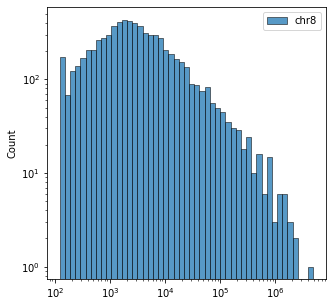

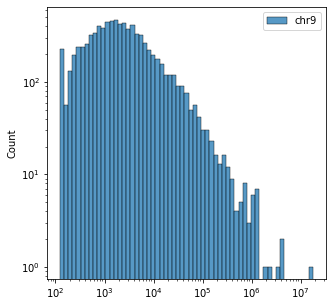

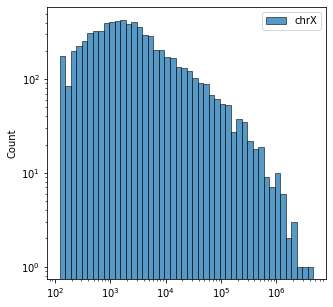

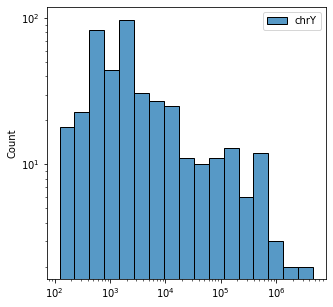

In [29]:
for c in data[0].unique():
    plt.figure(figsize=(5,5))
    sns.histplot(data[data[0]==c][2].values[1:] - data[data[0]==c][2].values[:-1], log_scale=(10, 10))
    plt.legend([c])

<AxesSubplot:>

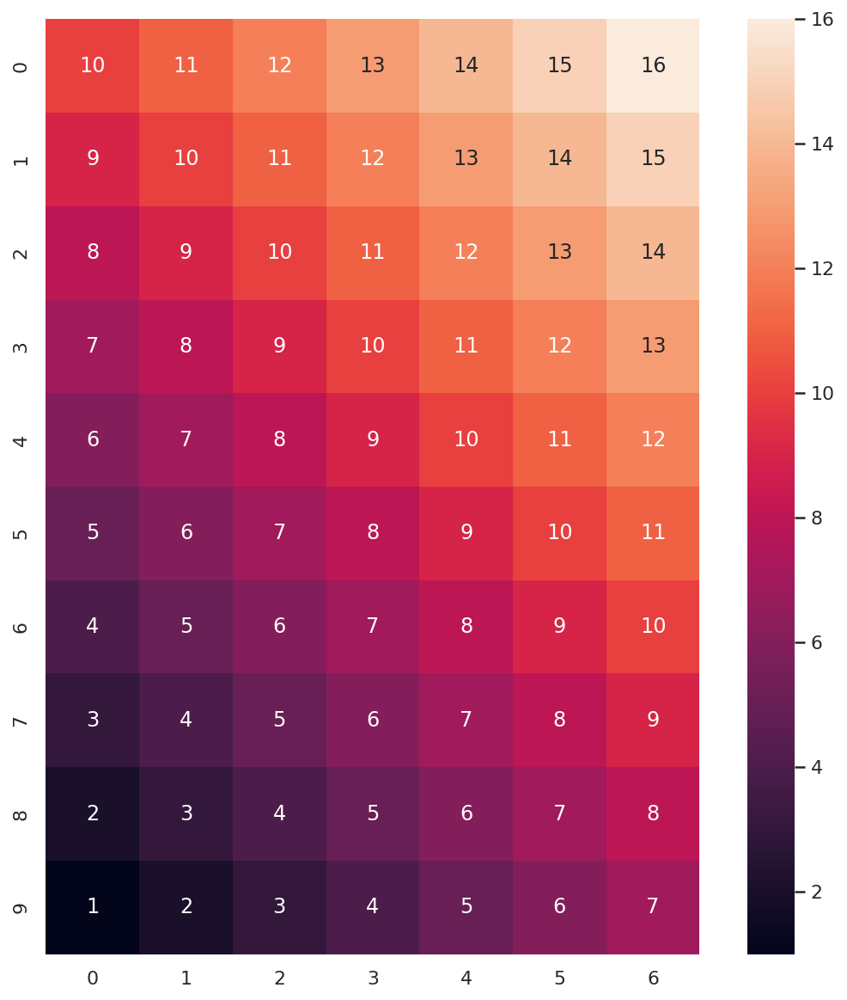

In [39]:
a = np.zeros((10,7))
for i in range(a.shape[0]):
    for j in range(a.shape[1]):
        a[i,j] = i+j+1

plt.figure(figsize=(10,10))
sns.heatmap(a[::-1,:], square=True, annot=True)

In [41]:
from exoc_funcs import data_loader

In [43]:
workdir = "/mnt/a/!Work/tmp/ExoC/"
pat, pat_chrshape, pat_cov = data_loader(workdir, f'sup_pat.XX.mcool', 13)

In [46]:
cvd_control = cooltools.expected_cis(
    clr=pat,
    view_df=None,
    smooth=False,
    aggregate_smoothed=False,
    nproc=10,
#     chunksize=chunksize,
    clr_weight_name = None,
    ignore_diags=1,
)

In [49]:
p_s = ((cvd_control.groupby('dist').sum()['count.sum']/cvd_control.groupby('dist').sum()['n_valid'])/pat_cov).values[1:]

<AxesSubplot:>

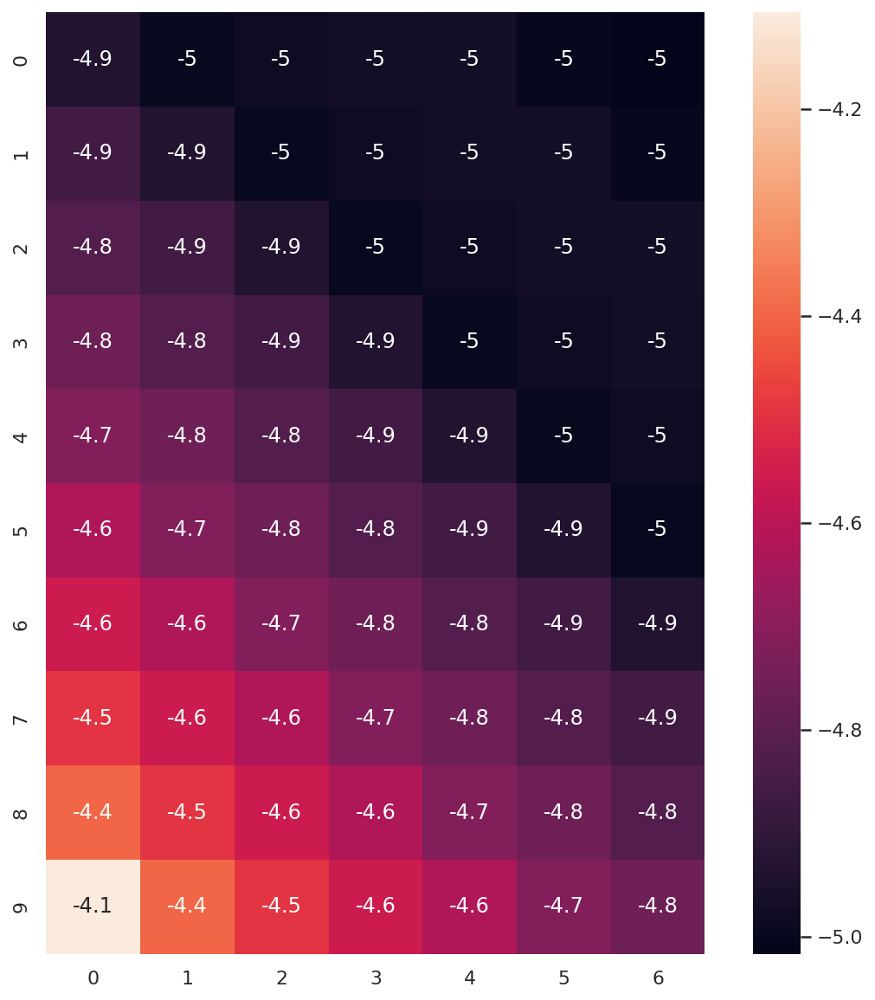

In [57]:
a = np.zeros((10,7))
for i in range(a.shape[0]):
    for j in range(a.shape[1]):
        a[i,j] = np.log10(p_s[i+j])
#         a[i,j] = p_s[i+j]

plt.figure(figsize=(10,10))
sns.heatmap(a[::-1,:], square=True, annot=True)

# Inversions

In [469]:
workdir = "/mnt/a/!Work/tmp/Exoc/accurasy_test/"

In [470]:
art_sample = {'arr[hg19]': [],
              'inversion': [],
              'translocation': [],
              'rob': [],
              'arr[GRCh37]': [],
              'der': [],
              'sex': None,
             }

In [471]:
artifacts_dict = {}
with open(workdir + 'all_translocations.txt') as file:
    line = file.readline()[:-1].split('\t')
    while len(line)>1:
        artifacts_dict[line[0]] = art_sample.copy()
        artifacts_dict[line[0]]['sex'] = line[1]
        for ar in line[2:]:
            if not ar == '':
                ar_type, ar_coords = ar.split(':')
                artifacts_dict[line[0]][ar_type] = ar_coords.split(',')
        
        line = file.readline()[:-1].split('\t')

In [472]:
artifacts_dict_base = {}
with open(workdir + 'all_translocations_base.txt') as file:
    line = file.readline()[:-1].split('\t')
    while len(line)>1:
        artifacts_dict_base[line[0]] = art_sample.copy()
        artifacts_dict_base[line[0]]['sex'] = line[1]
        for ar in line[2:]:
            if not ar == '':
                ar_type, ar_coords = ar.split(':')
                artifacts_dict_base[line[0]][ar_type] = ar_coords.split(',')
        
        line = file.readline()[:-1].split('\t')

In [473]:
def true_pair(artifacts_dict, pat_id, chr_pair):
    if pat_id in artifacts_dict.keys():
        if chr_pair in artifacts_dict[pat_id]['inversion']:
            return True
        else:
            return False
    else:
        return None

In [474]:
data_line = pd.DataFrame()
s4s = "-all_artifacts_line.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        try:
            tmp = pd.read_csv(workdir + file)
        except:
            pass
        else:
            tmp['pat_id'] = file.split('-')[0]
            data_line = data_line.append(tmp, ignore_index=True)
# data_line = pd.read_csv(workdir + f'full_table')
        
data_line['x_interval'] = data_line['x_interval'].apply(interval.from_str)
data_line['y_interval'] = data_line['y_interval'].apply(interval.from_str)

In [475]:
def XY_test(x):
    try:
        a = int(x)
    except ValueError:
        if x == 'X': a = 100
        if x == 'Y': a = 200
    return a

data_line['chr_pair'] = data_line[['from_chr', 'to_chr']].apply(lambda x: f'{x[0]}-{x[1]}' if int(XY_test(x[0][3:]))<int(XY_test(x[1][3:])) else f'{x[1]}-{x[0]}', axis=1)
data_line['true_pair'] = data_line[['pat_id', 'chr_pair']].apply(lambda x: true_pair(artifacts_dict, x[0], x[1]), axis=1)

In [476]:
data_base = pd.DataFrame()
s4s = "-all_artifacts.csv"
for file in os.listdir(workdir):
    if file[-len(s4s):]==s4s:
        tmp = pd.read_csv(workdir + file)
        tmp['pat_id'] = file.split('-')[0]
        data_base = data_base.append(tmp, ignore_index=True)
# data_base = pd.read_csv(workdir + f'full_table')
        
data_base['x_interval'] = data_base['x_interval'].apply(interval.from_str)
data_base['y_interval'] = data_base['y_interval'].apply(interval.from_str)

In [477]:
data_base = data_base[(data_base['prob'] > 0) * (data_base['chrX'] == data_base['chrY'])]
data_base['chr_pair'] = data_base['chrX']+'-'+data_base['chrY']
data_base['true_pair'] = data_base[['pat_id', 'chrX']].apply(lambda x: true_pair(artifacts_dict, x[0], x[1]), axis=1)

In [478]:
data_base[data_base['pat_id']=='s132_P10'][['chrX', 'chrY', 'prob', 'pat_sum', 'resolution']]

,chrX,chrY,prob,pat_sum,resolution
2544,chr11,chr11,32.005111,883,256000
2545,chr6,chr6,22.558670,404,256000
2546,chr19,chr19,21.078888,555,256000
2547,chr19,chr19,17.494625,77,256000
2548,chr6,chr6,11.549918,520,256000
...,...,...,...,...,...
4324,chr3,chr3,0.214398,1,1000
4325,chr6,chr6,0.196113,4,1000
4327,chr6,chr6,0.150608,3,1000
4328,chr2,chr2,0.137104,2,1000


In [479]:
data_base['pat_sum'] = data_base['pat_sum'].apply(lambda x: int(x))

In [480]:
fig = px.scatter(data_base, 
                 x = np.log10(abs(data_base['pat_sum'])),
                 y = np.log10(abs(data_base['prob'])),
                 hover_data = ['pat_id', 'chrX', 'chrY'],
                 color = 'true_pair',
                 symbol = 'resolution',
#                  symbol = 's_init',
                )
x = np.linspace(0.5,4.5,100)
k_base = (2.4 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
fig.add_trace(go.Scatter(
    x = x,
    y = k_base*x+b_base,
))


fig.update_layout(autosize=False, width=1000, height=800)
# fig.update_layout(xaxis={'range': [-0.02,1.02]},yaxis={'range': [-0.02,1.02]})
# fig.update_layout(legend=dict(
#     orientation="h",
#     yanchor="bottom",
#     y=1.02,
#     xanchor="left",
#     x=1
# ))
# fig.update_layout(hovermode=False)
fig.show()

In [481]:
k = 1.73
k_base = (2.4 - 0.74)/(3.62 - 1.81)
b_base = 0.74 - k_base*1.81
data_line['answer'] = ((np.exp(k*np.log10(data_line['counts_pat'])) < data_line['from_stat_binom']) | (data_line['from_stat_binom'] > 330))
data_base['answer'] = (data_base['resolution'] >= 16e3) & (np.log10(data_base['prob']) >= k_base*np.log10(data_base['pat_sum'])+b_base) & (data_base['pat_sum'] > 10)

In [43]:
answer_base = data_base[data_base['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_base: answer_base[pat_id] = list(answer_base[pat_id])
answer_line = data_line[data_line['answer']].groupby('pat_id')['chr_pair'].unique().to_dict()
for pat_id in answer_line: answer_line[pat_id] = list(answer_line[pat_id])
answer = answer_base.copy()
for pat_id in answer_line:
    if pat_id in answer:
        answer[pat_id] = list(set(answer_line[pat_id] + answer[pat_id]))
    else:
        answer[pat_id] = answer_line[pat_id]

for pat_id in artifacts_dict:
    if pat_id in answer:
        print(pat_id)
        print(sorted(answer[pat_id]))
        print(sorted(artifacts_dict[pat_id]['translocation'] + artifacts_dict[pat_id]['rob']))

    else:
        print(pat_id)
        print('----')
        print(sorted(artifacts_dict[pat_id]['translocation']))
    
    print()

s90_P26
----
['chr1-chr22']

s91_P31
----
[]

s92_P32
----
[]

s93_P35
['chr9-chrX']
['chr9-chrX']

s95_P37
['chr9-chr17']
[]

s96_P38
['chr11-chr19', 'chr14-chr19']
[]

s97_P40
----
[]

s98_P39
----
[]

s132_P10
['chr4-chr13', 'chr5-chr10']
['chr4-chr13', 'chr5-chr10']

s133_P42
['chr4-chr12', 'chr9-chr19']
['chr4-chr12']

s134_P43
['chr2-chr4', 'chr4-chr11', 'chr8-chr17']
['chr2-chr4']

s135_P46
['chr6-chr18', 'chr6-chr21']
['chr6-chr18', 'chr6-chr21']

s136_P47
['chr11-chr20', 'chr20-chr21', 'chr8-chr11', 'chr8-chr20', 'chr8-chr21']
['chr11-chr20', 'chr20-chr21', 'chr8-chr11', 'chr8-chr20', 'chr8-chr21']

s137_P48
----
[]

s138_P49
----
[]

s139_P50
['chr1-chr9']
['chr1-chr9']

s140_P51
['chr1-chr9']
['chr1-chr9']

s141_P52
----
[]

s159_P44
['chr5-chr13']
['chr5-chr13']

s160_P45
['chr1-chr4', 'chr13-chr14', 'chr9-chr14']
['chr13-chr14']

s161_P53
----
[]

s162_P54
['chr2-chr18']
['chr2-chr18']

s163_P55
['chr3-chr16', 'chr3-chr6', 'chr6-chr16', 'chr6-chr7', 'chr7-chr16']
['chr3-ch

# Cis/trans normalization?

In [485]:
import numpy as np
import pandas as pd
from numpy.random import binomial as binom
from scipy.stats import binom as sbinom
from scipy.special import gamma, gammaln

import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns

sns.set()

# Graphics in retina format are more sharp and legible
%config InlineBackend.figure_format = 'retina'

In [486]:
def my_logpmf(x, depth, prob):
    return gammaln(depth+1) - gammaln(x+1) - gammaln(depth-x+1) + x*np.log(prob) + (depth-x)*np.log(1-prob)

def my_log10pmf(x, depth, prob):
    return my_logpmf(x, depth, prob)*np.log10(np.exp(1))

In [499]:
size = 16
chr_size = 10
max_n = int(1e7)
ctr_control = 0.65
ctr_pat = 0.9
de_control = 0.53
de_pat = 0.53

DE: 82.16594000489964
DE: 53.000000000000014
Cis/trans: 92.54741490102421/7.452585098975783
Cis/trans: 65.00000000000001/34.999999999999986
Depth: 10000058, Expected: 10000000, ratio: 1.0000058


<AxesSubplot:>

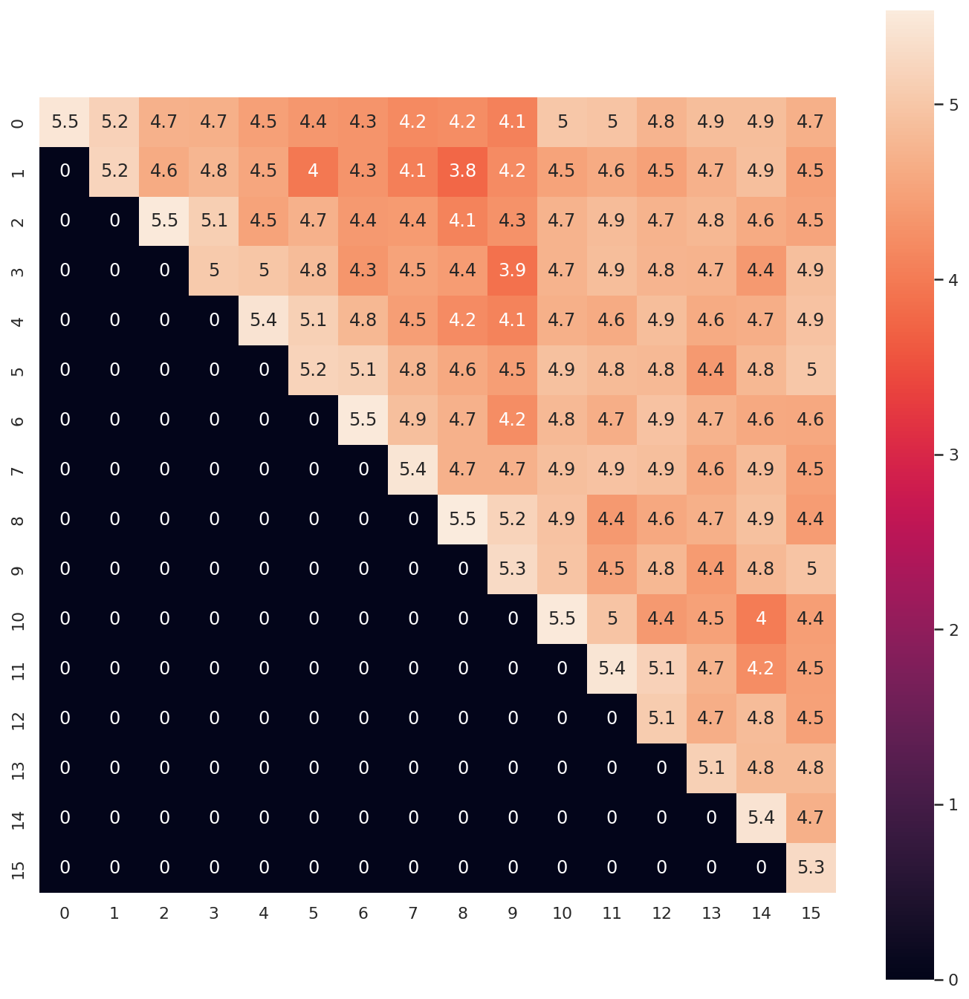

In [500]:
a = 1-np.random.random((size,size))/1.3 # Hi-C before sequensing
for i in range(size):
    for j in range(i,size):
        if j >= chr_size and i < chr_size:
            a[i,j] = a[i,j]/((chr_size)*10)
        elif j-i > 0:
            a[i,j] = a[i,j]/((j-i)*10)
        a[j,i] = a[i,j]

a = np.triu(a)

de = (a*np.eye(*a.shape)).sum()/a.sum()
print(f'DE: {de*100}')
a = a*np.eye(*a.shape)/de*de_control + (a - a*np.eye(*a.shape))/(1-de)*(1-de_control)
de = (a*np.eye(*a.shape)).sum()/a.sum()
print(f'DE: {de*100}')

ctr = (a[:chr_size,:chr_size].sum() + a[chr_size:,chr_size:].sum())/(a.sum())
print(f'Cis/trans: {ctr*100}/{(1-ctr)*100}')
a[:chr_size,:chr_size] = a[:chr_size,:chr_size]/ctr*ctr_control
a[chr_size:,chr_size:] = a[chr_size:,chr_size:]/ctr*ctr_control
a[chr_size:,:chr_size] = a[chr_size:,:chr_size]/(1-ctr)*(1-ctr_control)
a[:chr_size,chr_size:] = a[:chr_size,chr_size:]/(1-ctr)*(1-ctr_control)
ctr = (a[:chr_size,:chr_size].sum() + a[chr_size:,chr_size:].sum())/(a.sum())
print(f'Cis/trans: {ctr*100}/{(1-ctr)*100}')

a = np.triu(a/a.sum())

a_counts = np.triu(binom(max_n, a))
print(f'Depth: {a_counts.sum()}, Expected: {max_n}, ratio: {a_counts.sum()/max_n}')

plt.figure(figsize=(12,12))
sns.heatmap(np.log10(a_counts+1), square=True, annot=True) 

DE: 30.98882050096235
DE: 53.0
Cis/trans: 68.74801010378178/31.251989896218223
Cis/trans: 90.0/9.999999999999998
Depth: 2575, Expected: 2500, ratio: 1.03


<AxesSubplot:>

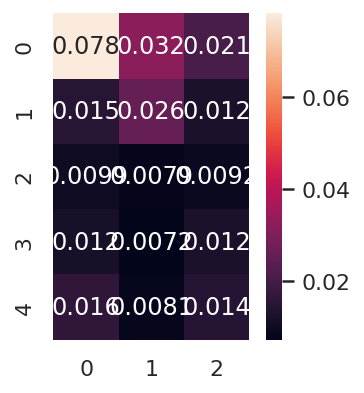

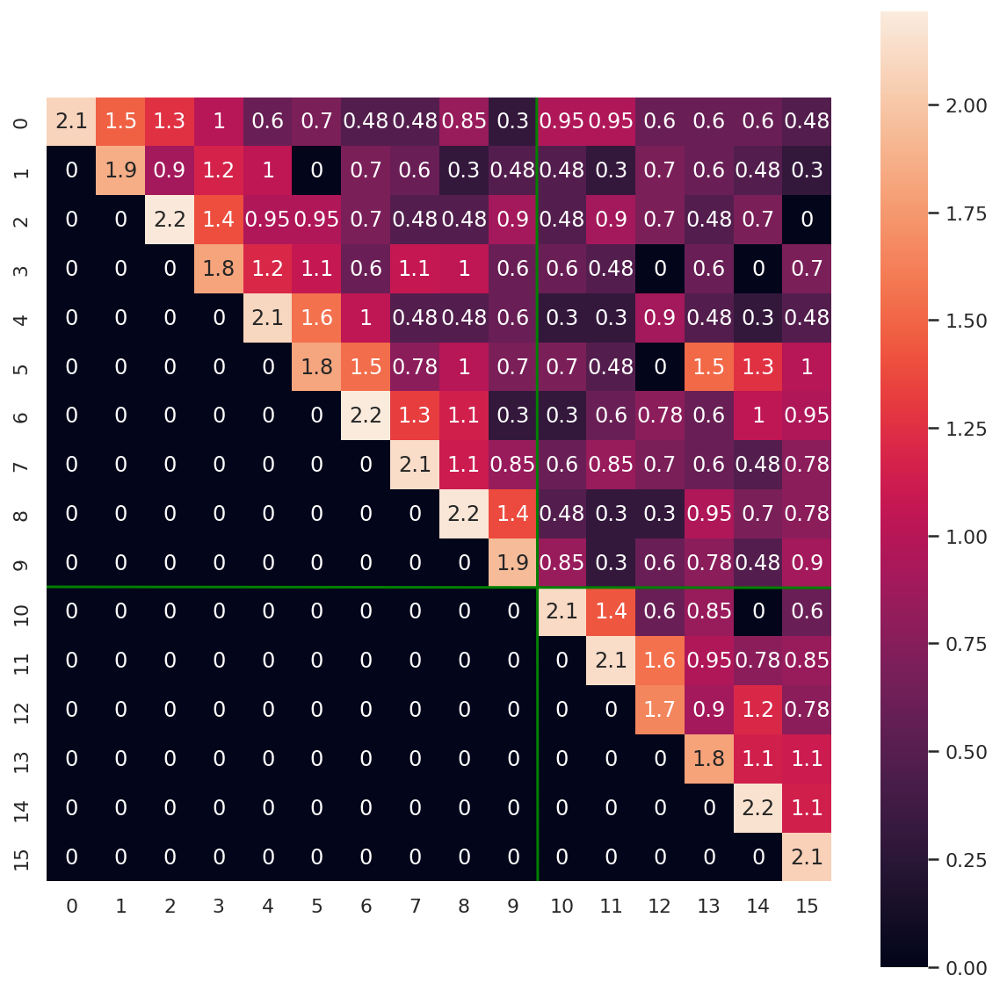

In [501]:
depth = int(a_counts.sum()/int(4e3))
b = a.copy()

tr = 1-np.random.random((5,3))/1.3
for i in range(tr.shape[0]):
    for j in range(tr.shape[1]):
        tr[i,j] = tr[i,j]/((j-i+tr.shape[0])*10)
tr = tr[::-1,:]
plt.figure(figsize=(3,3))
sns.heatmap(tr, square=True, annot=True)

b[5:10,13:16] = tr

de = (b*np.eye(*b.shape)).sum()/b.sum()
print(f'DE: {de*100}')
b = b*np.eye(*b.shape)/de*de_pat + (b - b*np.eye(*b.shape))/(1-de)*(1-de_pat)
de = (b*np.eye(*b.shape)).sum()/b.sum()
print(f'DE: {de*100}')

ctr = (b[:chr_size,:chr_size].sum() + b[chr_size:,chr_size:].sum())/(b.sum())
print(f'Cis/trans: {ctr*100}/{(1-ctr)*100}')
b[:chr_size,:chr_size] = b[:chr_size,:chr_size]/ctr*ctr_pat
b[chr_size:,chr_size:] = b[chr_size:,chr_size:]/ctr*ctr_pat
b[chr_size:,:chr_size] = b[chr_size:,:chr_size]/(1-ctr)*(1-ctr_pat)
b[:chr_size,chr_size:] = b[:chr_size,chr_size:]/(1-ctr)*(1-ctr_pat)
ctr = (b[:chr_size,:chr_size].sum() + b[chr_size:,chr_size:].sum())/(b.sum())
print(f'Cis/trans: {ctr*100}/{(1-ctr)*100}')

b = np.triu(b/b.sum())

b_counts = np.triu(binom(depth, b))
print(f'Depth: {b_counts.sum()}, Expected: {depth}, ratio: {b_counts.sum()/depth}')

plt.figure(figsize=(10,10))
sns.heatmap(np.log10(b_counts+1), square=True, annot=True)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green')
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green')

10000058
0.8999999999999999
10000058.0
0.9000000000000001
9801169.0


<AxesSubplot:title={'center':'After cis/trans correction dots cut'}>

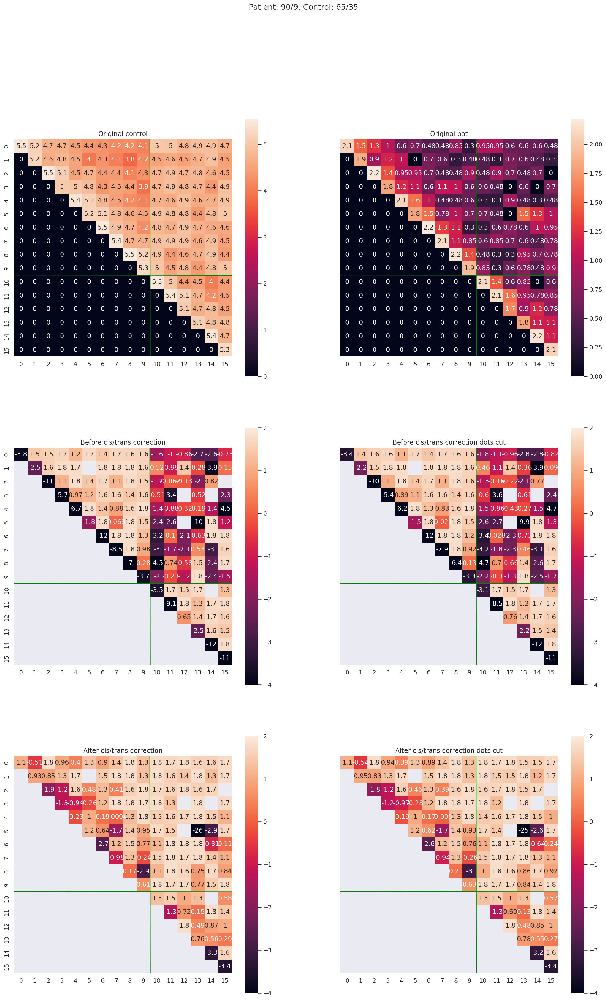

In [502]:
f, ax = plt.subplots(3, 2, sharey=True, figsize=(20,30))
f.suptitle(f'Patient: {int(ctr_pat*100)}/{int((1-ctr_pat)*100)}, Control: {int(ctr_control*100)}/{int((1-ctr_control)*100)}')

tm_ax = ax[0,0]
tm_ax.set_title('Original control')
sns.heatmap(np.log10(a_counts+1), square=True, annot=True, ax=tm_ax)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

tm_ax = ax[0,1]
tm_ax.set_title('Original pat')
sns.heatmap(np.log10(b_counts+1), square=True, annot=True, ax=tm_ax)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

mask = b_counts > 0

c1 = my_log10pmf(b_counts, b_counts.sum(), a_counts/a_counts.sum()) - \
     my_log10pmf(a_counts, a_counts.sum(), a_counts/a_counts.sum())
tm_ax = ax[1,0]
tm_ax.set_title('Before cis/trans correction')
sns.heatmap(c1/mask, square=True, annot=True, ax=tm_ax, vmin=-4, vmax=2)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

c2 = my_log10pmf(b_counts, b_counts.sum(), (a_counts*mask)/(a_counts*mask).sum()) - \
     my_log10pmf(a_counts*mask, (a_counts*mask).sum(), (a_counts*mask)/(a_counts*mask).sum())
tm_ax = ax[1,1]
tm_ax.set_title('Before cis/trans correction dots cut')
sns.heatmap(c2/mask, square=True, annot=True, ax=tm_ax, vmin=-4, vmax=2)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

print(a_counts.sum())

mask = b_counts > 0

a1 = (a_counts*1.0).copy()
ctr = (a1[:chr_size,:chr_size].sum() + a1[chr_size:,chr_size:].sum())/(a1.sum())
a1[:chr_size,:chr_size] = a1[:chr_size,:chr_size]/ctr*ctr_pat
a1[chr_size:,chr_size:] = a1[chr_size:,chr_size:]/ctr*ctr_pat
a1[chr_size:,:chr_size] = a1[chr_size:,:chr_size]/(1-ctr)*(1-ctr_pat)
a1[:chr_size,chr_size:] = a1[:chr_size,chr_size:]/(1-ctr)*(1-ctr_pat)
print((a1[:chr_size,:chr_size].sum() + a1[chr_size:,chr_size:].sum())/(a1.sum()))
print(a1.sum())

c1 = my_log10pmf(b_counts, b_counts.sum(), a1/a1.sum()) - \
     my_log10pmf(a1, a1.sum(), a1/a1.sum())
tm_ax = ax[2,0]
tm_ax.set_title('After cis/trans correction')
sns.heatmap(c1/mask, square=True, annot=True, ax=tm_ax, vmin=-4, vmax=2)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

a2 = (a_counts*mask*1.0).copy()
ctr = (a2[:chr_size,:chr_size].sum() + a2[chr_size:,chr_size:].sum())/(a2.sum())
a2[:chr_size,:chr_size] = a2[:chr_size,:chr_size]/ctr*ctr_pat
a2[chr_size:,chr_size:] = a2[chr_size:,chr_size:]/ctr*ctr_pat
a2[chr_size:,:chr_size] = a2[chr_size:,:chr_size]/(1-ctr)*(1-ctr_pat)
a2[:chr_size,chr_size:] = a2[:chr_size,chr_size:]/(1-ctr)*(1-ctr_pat)
print((a2[:chr_size,:chr_size].sum() + a2[chr_size:,chr_size:].sum())/(a2.sum()))
print(a2.sum())

c2 = my_log10pmf(b_counts, b_counts.sum(), a2/a2.sum()) - \
     my_log10pmf(a2, a2.sum(), a2/a2.sum())
tm_ax = ax[2,1]
tm_ax.set_title('After cis/trans correction dots cut')
sns.heatmap(c2/mask, square=True, annot=True, ax=tm_ax, vmin=-4, vmax=2)
sns.lineplot(x=[chr_size*0.999,chr_size*1.001], y=[0,size], color='green', ax=tm_ax)
sns.lineplot(y=[chr_size*0.999,chr_size*1.001], x=[0,size], color='green', ax=tm_ax)

<AxesSubplot:>

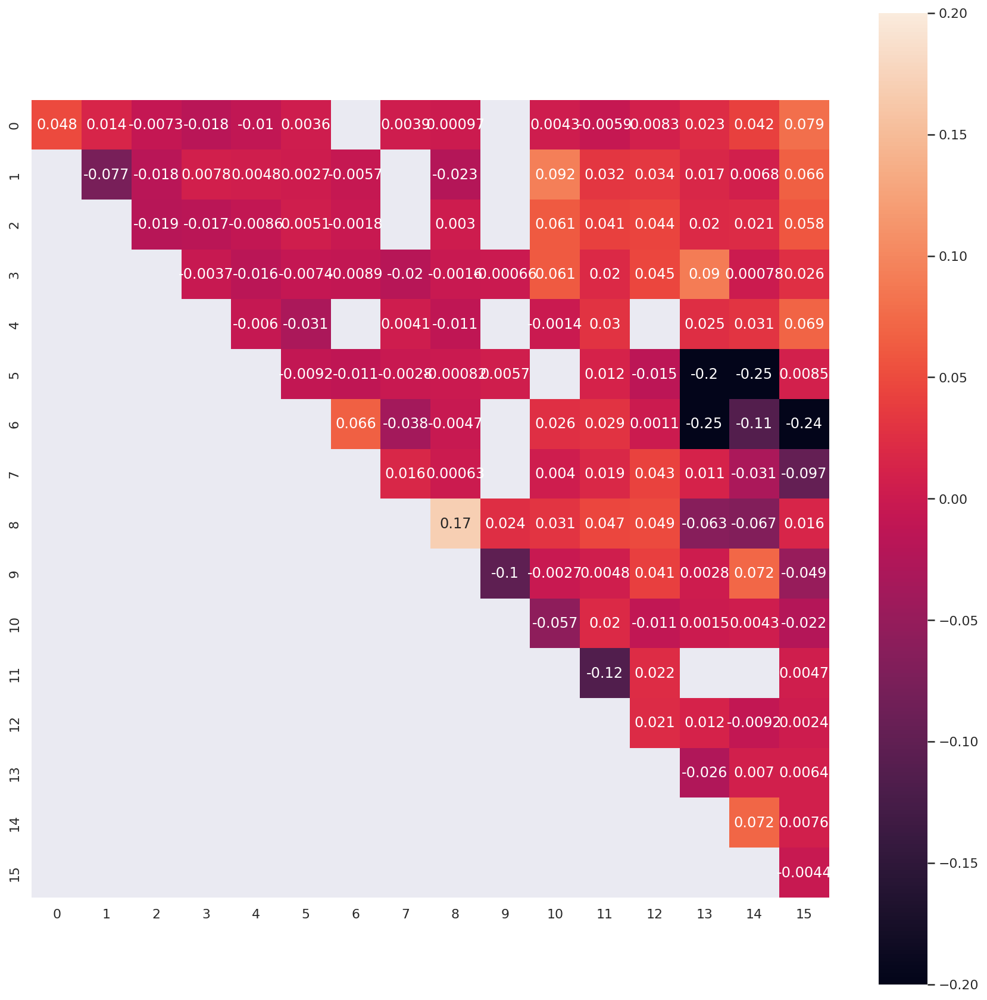

In [425]:
plt.figure(figsize=(15,15))
sns.heatmap((c1-c2)/mask, square=True, annot=True, vmin=-0.2, vmax=0.2)

<AxesSubplot:>

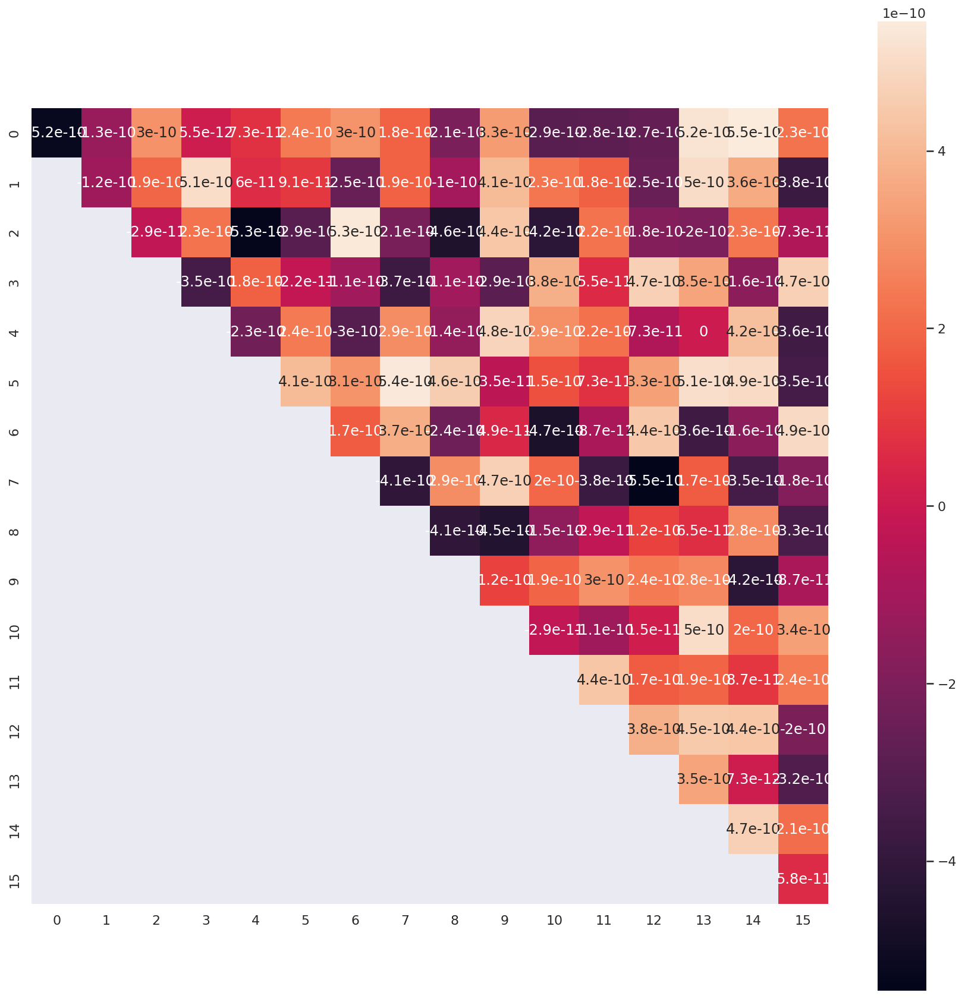

In [349]:
g1 = sbinom.logpmf(a_counts, a_counts.sum(), a_counts/a_counts.sum())
g2 = my_logpmf(a_counts, a_counts.sum(), a_counts/a_counts.sum())

plt.figure(figsize=(15,15))
sns.heatmap(g1-g2, square=True, annot=True)

<AxesSubplot:>

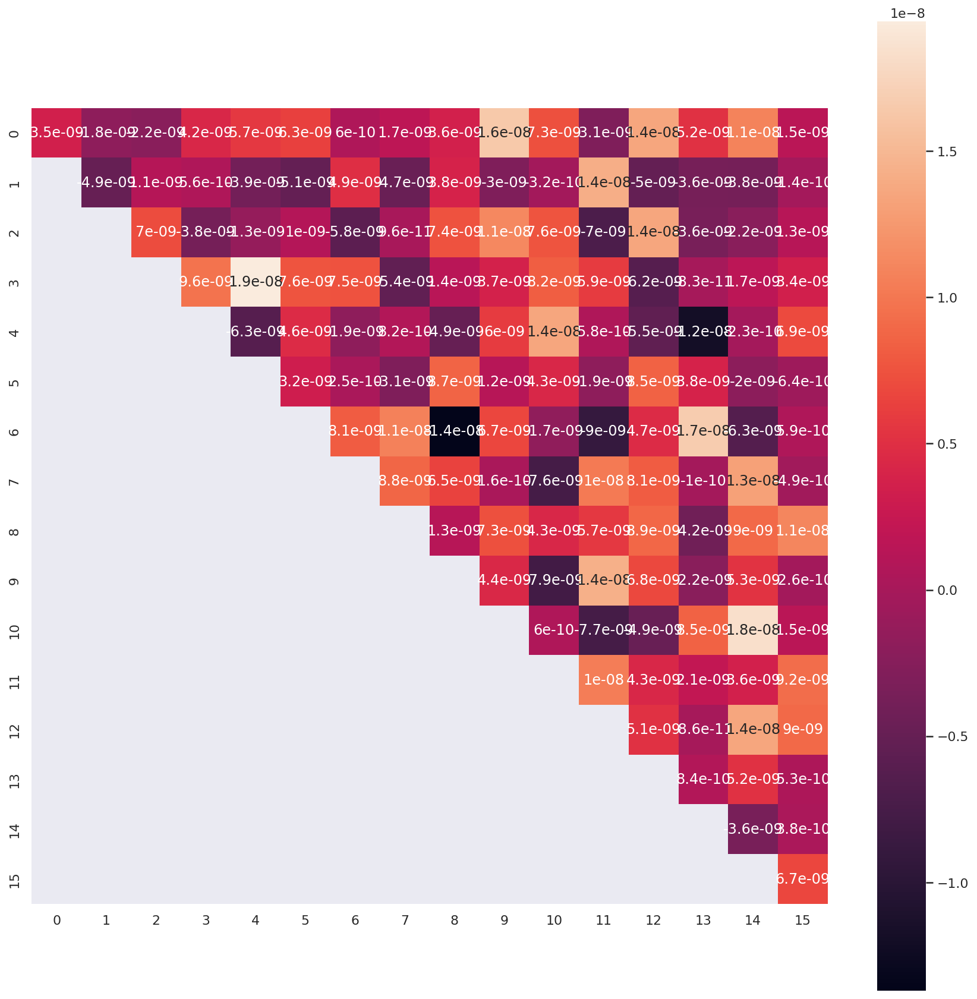

In [353]:
g1 = np.log10(sbinom.pmf(a_counts, a_counts.sum(), a_counts/a_counts.sum()))
g2 = my_log10pmf(a_counts, a_counts.sum(), a_counts/a_counts.sum())

plt.figure(figsize=(15,15))
sns.heatmap(g1-g2, square=True, annot=True)

In [437]:
print(a_counts.sum())

a1 = (a_counts*1.0).copy()
ctr = (a1[:chr_size,:chr_size].sum() + a1[chr_size:,chr_size:].sum())/(a1.sum())
a1[:chr_size,:chr_size] = a1[:chr_size,:chr_size]/ctr*ctr_pat
a1[chr_size:,chr_size:] = a1[chr_size:,chr_size:]/ctr*ctr_pat
a1[chr_size:,:chr_size] = a1[chr_size:,:chr_size]/(1-ctr)*(1-ctr_pat)
a1[:chr_size,chr_size:] = a1[:chr_size,chr_size:]/(1-ctr)*(1-ctr_pat)
print((a1[:chr_size,:chr_size].sum() + a1[chr_size:,chr_size:].sum())/(a1.sum()))
print(a1.sum())

a2 = (a_counts*mask*1.0).copy()
ctr = (a2[:chr_size,:chr_size].sum() + a2[chr_size:,chr_size:].sum())/(a2.sum())
a2[:chr_size,:chr_size] = a2[:chr_size,:chr_size]/ctr*ctr_pat
a2[chr_size:,chr_size:] = a2[chr_size:,chr_size:]/ctr*ctr_pat
a2[chr_size:,:chr_size] = a2[chr_size:,:chr_size]/(1-ctr)*(1-ctr_pat)
a2[:chr_size,chr_size:] = a2[:chr_size,chr_size:]/(1-ctr)*(1-ctr_pat)
print((a2[:chr_size,:chr_size].sum() + a2[chr_size:,chr_size:].sum())/(a2.sum()))
print(a2.sum())

9991984
0.8999999999999999
9991984.0
0.9000000000000001
9767234.0
